To measure model performance we will use the test portion of the data and determine stats including ROC curve

In [ ]:
# installations
!pip uninstall -y tensorflow keras

Uninstalling tensorflow-2.2.0:
  Successfully uninstalled tensorflow-2.2.0
Uninstalling Keras-2.3.1:
  Successfully uninstalled Keras-2.3.1


In [1]:
!nvcc --version
!wget https://developer.nvidia.com/compute/cuda/9.0/Prod/local_installers/cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb
!dpkg -i cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb
!apt-key add /var/cuda-repo-9-0-local/7fa2af80.pub
!apt-get update
!apt-get install cuda=9.0.176-1
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Wed_Jul_22_19:09:09_PDT_2020
Cuda compilation tools, release 11.0, V11.0.221
Build cuda_11.0_bu.TC445_37.28845127_0
--2021-05-02 09:42:36--  https://developer.nvidia.com/compute/cuda/9.0/Prod/local_installers/cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb
Resolving developer.nvidia.com (developer.nvidia.com)... 152.199.0.24
Connecting to developer.nvidia.com (developer.nvidia.com)|152.199.0.24|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://developer.nvidia.com/compute/cuda/9.0/prod/local_installers/cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb [following]
--2021-05-02 09:42:36--  https://developer.nvidia.com/compute/cuda/9.0/prod/local_installers/cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb
Reusing existing connection to developer.nvidia.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://developer.download

In [2]:
# installations
!pip install -q tensorflow-gpu==1.12.0 keras==2.1.6 scikit-learn==0.20.0 pandas==0.25.0 numpy==1.16.0 keras-vis
!pip install opencv-python


ERROR: Could not find a version that satisfies the requirement tensorflow-gpu==1.12.0 (from versions: 1.13.1, 1.13.2, 1.14.0, 1.15.0rc0, 1.15.0rc1, 1.15.0rc2, 1.15.0rc3, 1.15.0, 1.15.2, 1.15.3, 1.15.4, 1.15.5, 2.0.0a0, 2.0.0b0, 2.0.0b1, 2.0.0rc0, 2.0.0rc1, 2.0.0rc2, 2.0.0, 2.0.1, 2.0.2, 2.0.3, 2.0.4, 2.1.0rc0, 2.1.0rc1, 2.1.0rc2, 2.1.0, 2.1.1, 2.1.2, 2.1.3, 2.2.0rc0, 2.2.0rc1, 2.2.0rc2, 2.2.0rc3, 2.2.0rc4, 2.2.0, 2.2.1, 2.2.2, 2.3.0rc0, 2.3.0rc1, 2.3.0rc2, 2.3.0, 2.3.1, 2.3.2, 2.4.0rc0, 2.4.0rc1, 2.4.0rc2, 2.4.0rc3, 2.4.0rc4, 2.4.0, 2.4.1, 2.5.0rc0, 2.5.0rc1, 2.5.0rc2)
ERROR: No matching distribution found for tensorflow-gpu==1.12.0


In [3]:
!pip install pillow
!pip install scipy==1.1.0

     |████████████████████████████████| 31.2MB 103kB/s 
ERROR: plotnine 0.6.0 has requirement scipy>=1.2.0, but you'll have scipy 1.1.0 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1


In [4]:
# mount google drive
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [5]:
# imports
from __future__ import print_function
import numpy as np
import pandas as pd
import time
import os
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline
from keras.callbacks import TensorBoard, EarlyStopping, ModelCheckpoint
from keras import losses
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from keras.models import model_from_json
from keras import backend as K
from keras.layers import Input, Flatten, Dense, Dropout, AveragePooling2D # Dropout, Convolution2D, Flatten, MaxPool2D
from keras.optimizers import Adam, SGD
from keras.models import Model
from keras.applications.inception_v3 import InceptionV3
from collections import Counter
from keras import regularizers

In [6]:
def ShowImage(im, title='', ax=None):
  if ax is None:
    plt.figure()
  plt.axis('off')
  im = ((im + 1) * 127.5).astype(np.uint8)
  plt.imshow(im)
  plt.title(title)

def ShowHeatMap(im, title='', ax=None):
  if ax is None:
    plt.figure()
  plt.axis('off')
  plt.imshow(im, cmap='inferno')
  plt.title(title)

In [9]:
# inference



modelFile = '/content/drive/My Drive/worm_models/lifespan/models/wormNet.json'
weightsFile = '/content/drive/My Drive/worm_models/lifespan/models/3d/2/weights.150-0.87.hdf5'

img_width, img_height = 900, 900
batchSize = 10
testSamplesNumber = 20

with open(modelFile, 'r', encoding='utf-8') as f:
  model = model_from_json(f.read())
model.summary()
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr=0.01, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0),
              metrics=['accuracy'])
model.load_weights(weightsFile, by_name=False)
model.save('/content/drive/My Drive/worm_models/lifespan/models/3d/2/model.h5',save_format='tf')


Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 150, 150, 96)      11712     
_________________________________________________________________
spatial_dropout2d_6 (Spatial (None, 150, 150, 96)      0         
_________________________________________________________________
batch_normalization_7 (Batch (None, 150, 150, 96)      384       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 75, 75, 96)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 71, 71, 256)       614656    
_________________________________________________________________
spatial_dropout2d_7 (Spatial (None, 71, 71, 256)       0         
_________________________________________________________________
batch_normalization_8 (Batch (None, 71, 71, 256)      

In [ ]:
import cv2
from PIL import Image
from vis.utils  import utils
from vis.visualization import visualize_cam #, visualize_saliency, get_num_filters
import re

def plotNSave(im,file,grads):
    f, ax = plt.subplots(1, 3)
    ax[0].imshow(im, alpha=1)
    ax[1].imshow(grads, cmap='jet')
    ax[2].imshow(grads, cmap='jet')
    ax[2].imshow(im, alpha=0.5)
    f.savefig(file, bbox_inches='tight')

def listImages(folder, endPattern):
    data = list()
    for root, dirs, files in os.walk(folder):
        for file in files:
            if file.endswith(endPattern):
                 data.append(file)
    return data

def checkDir(directory):
    if not os.path.exists(directory):
        os.makedirs(directory)
        
testFolder = '/content/drive/My Drive/worm_models/lifespan/test_images/3d/short'
images = listImages(testFolder,".png")
print(images)
#imageFolder = os.path.join(testFolder,'CAM')
#checkDir(imageFolder)          
#layer_idx = utils.find_layer_idx(model,'avg_pool')
plt.rcParams['figure.figsize']=(18,6)

for image in images:
    imgPath = os.path.join(testFolder,image)
    im = cv2.resize(cv2.imread(imgPath, cv2.IMREAD_GRAYSCALE), (img_width, img_height))
    im = np.round(im.astype(float)*2.6).astype(int).reshape(img_width, img_height, 1)
    #plt.imshow(im)
    plt.figure()
    modifier = 'guided'
    #modifier = 'relu'
    #grads = visualize_saliency(model, layer_idx, filter_indices=0, seed_input=im, backprop_modifier=modifier)
    grads = visualize_cam(model, layer_idx=17, filter_indices=None, seed_input=im, backprop_modifier=modifier)
    file_name = re.sub(r"png", "pdf",imgPath)
    plotNSave(np.squeeze(im),file_name,grads)
    cv2.imwrite(file_name.replace('.pdf','_cam.tif'),grads)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
model.layers[17]

In [ ]:
im.reshape(900, 900, 1).shape

(900, 900, 1)

['100_2016-03-01t1520_bf_crop_y1210-x1072_.png', '0_2016-04-03t2049_bf_crop_y1333-x1092_.png', '101_2016-03-18t1309_bf_crop_y1208-x1073_.png', '102_2016-04-03t2049_bf_crop_y1569-x1352_.png', '105_2016-03-18t1309_bf_crop_y1351-x1111_.png', '103_2016-03-29t0309_bf_crop_y1413-x950_.png', '104_2016-03-29t0517_bf_crop_y1068-x1263_.png', '107_2016-03-17t2229_bf_crop_y1338-x1557_.png', '108_2016-03-01t0040_bf_crop_y1354-x1404_.png', '106_2016-03-18t1013_bf_crop_y1219-x1699_.png', '109_2016-04-04t0241_bf_crop_y1461-x1155_.png', '10_2016-02-29t1832_bf_crop_y1007-x998_.png', '110_2016-03-29t1157_bf_crop_y820-x1277_.png', '111_2016-03-28t2029_bf_crop_y678-x1056_.png', '112_2016-02-23t2141_bf_crop_y833-x998_.png', '114_2016-03-17t2229_bf_crop_y1262-x1108_.png', '113_2016-03-29t0309_bf_crop_y1253-x1521_.png', '115_2016-03-18t0717_bf_crop_y1330-x1554_.png', '116_2016-03-28t2029_bf_crop_y923-x1702_.png', '135_2016-04-04t0241_bf_crop_y1214-x1608_.png', '117_2016-03-29t0309_bf_crop_y883-x1529_.png', '1

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warn

<Figure size 1296x432 with 0 Axes>

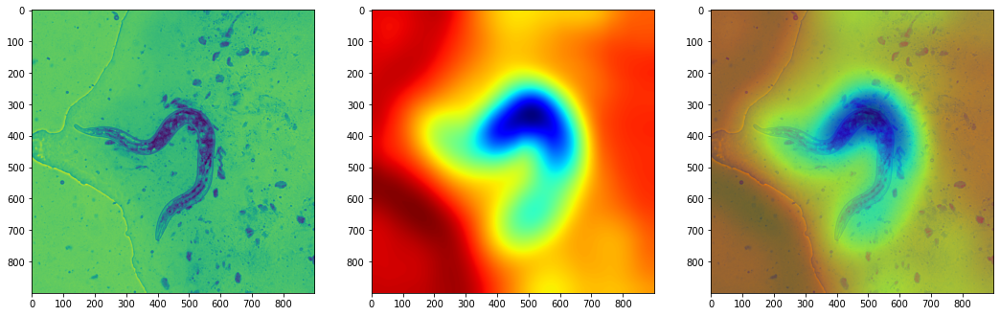

<Figure size 1296x432 with 0 Axes>

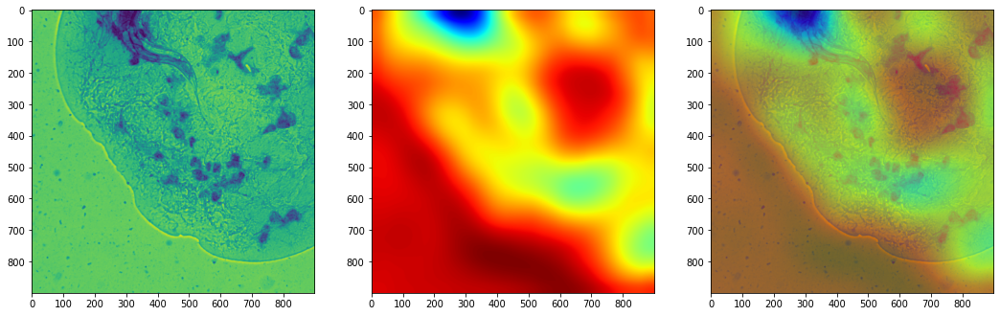

<Figure size 1296x432 with 0 Axes>

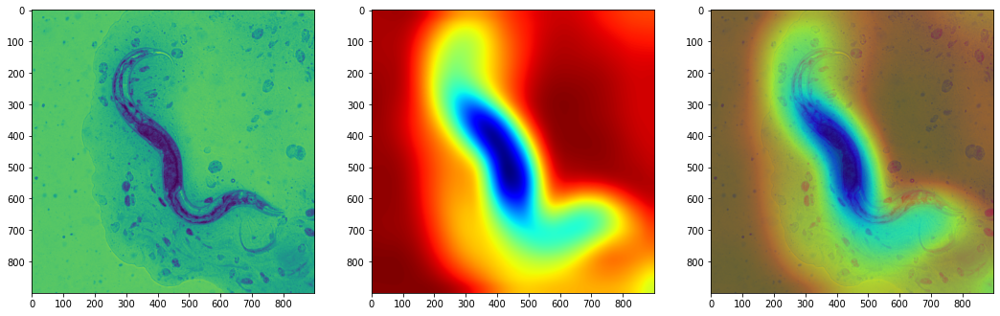

<Figure size 1296x432 with 0 Axes>

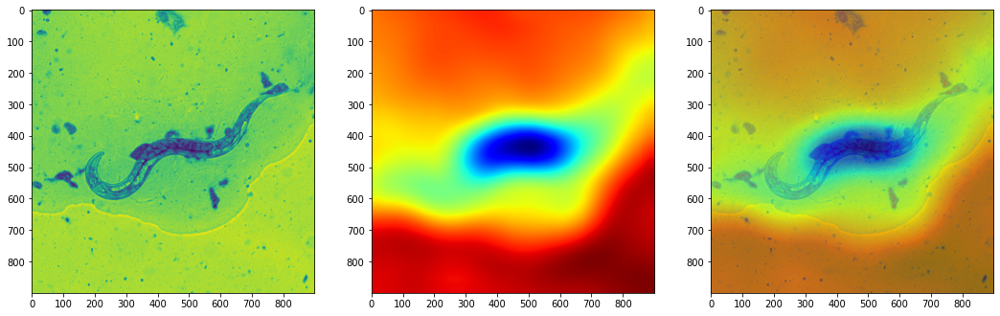

<Figure size 1296x432 with 0 Axes>

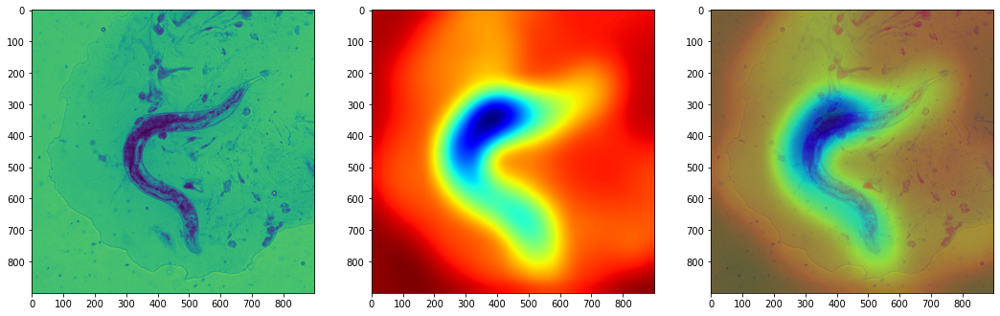

<Figure size 1296x432 with 0 Axes>

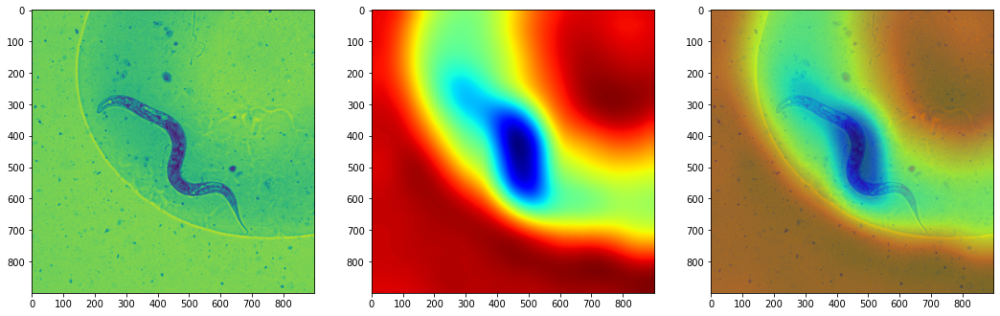

<Figure size 1296x432 with 0 Axes>

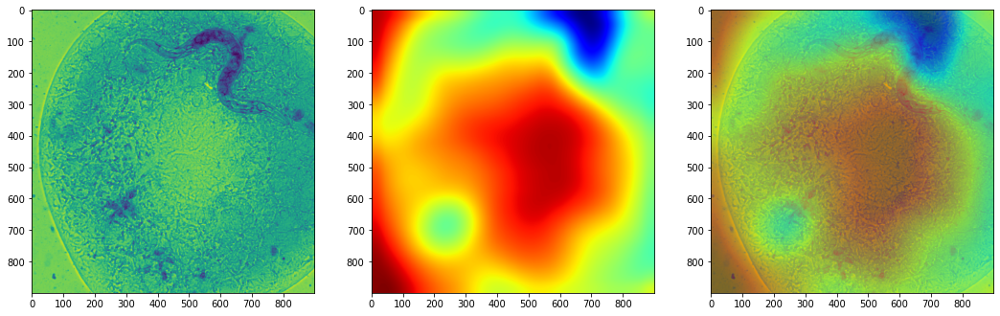

<Figure size 1296x432 with 0 Axes>

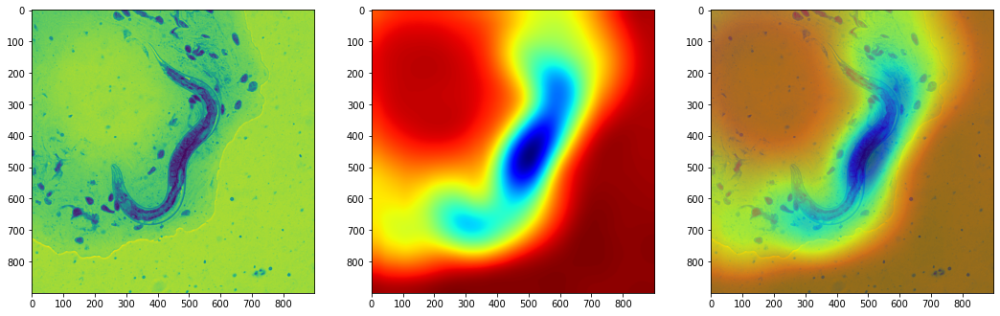

<Figure size 1296x432 with 0 Axes>

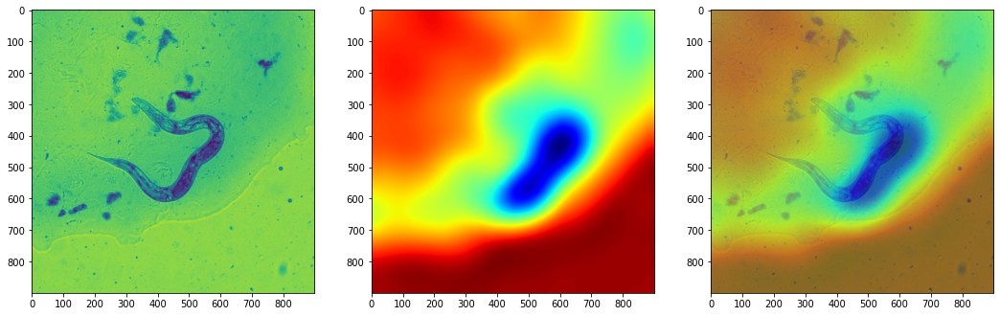

<Figure size 1296x432 with 0 Axes>

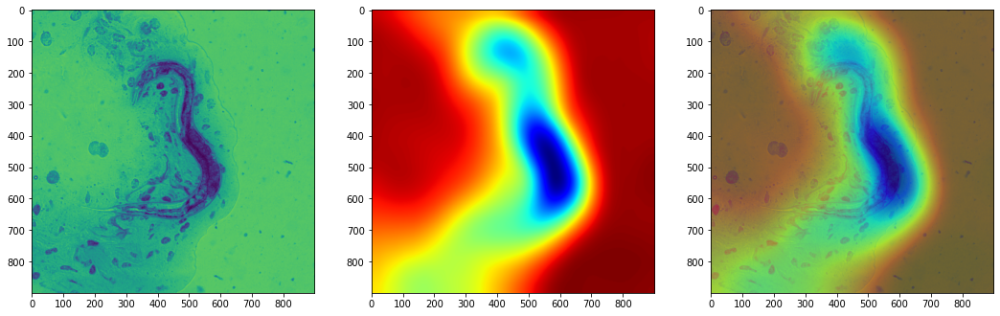

<Figure size 1296x432 with 0 Axes>

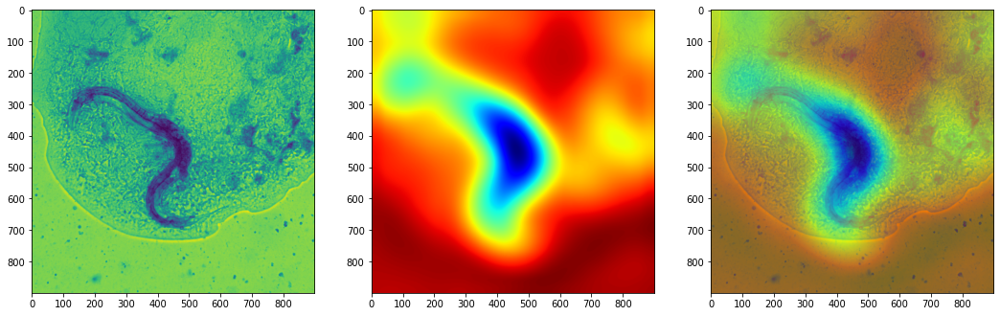

<Figure size 1296x432 with 0 Axes>

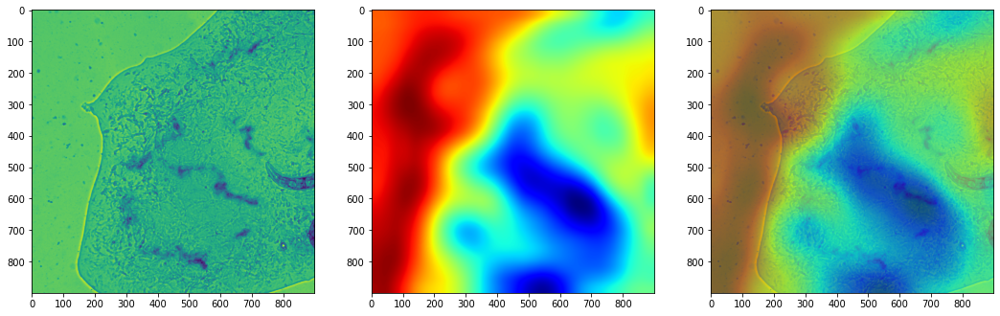

<Figure size 1296x432 with 0 Axes>

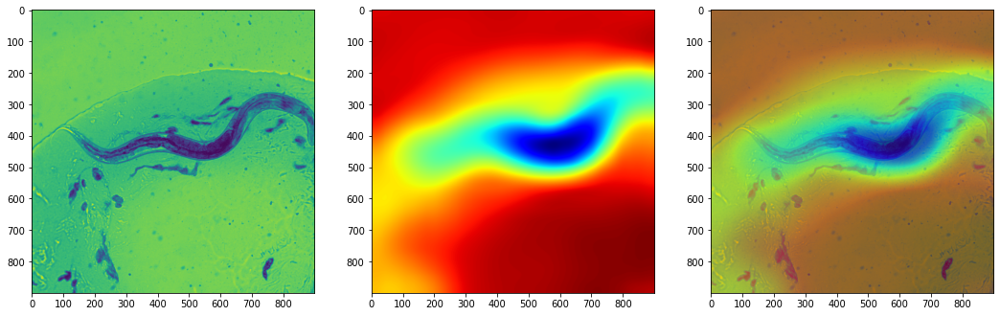

<Figure size 1296x432 with 0 Axes>

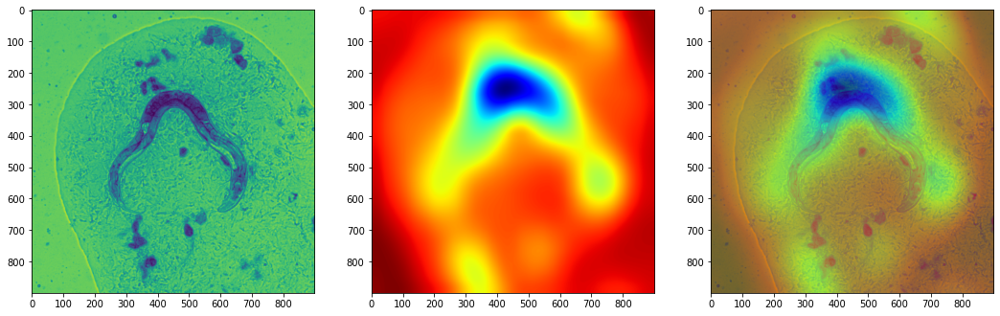

<Figure size 1296x432 with 0 Axes>

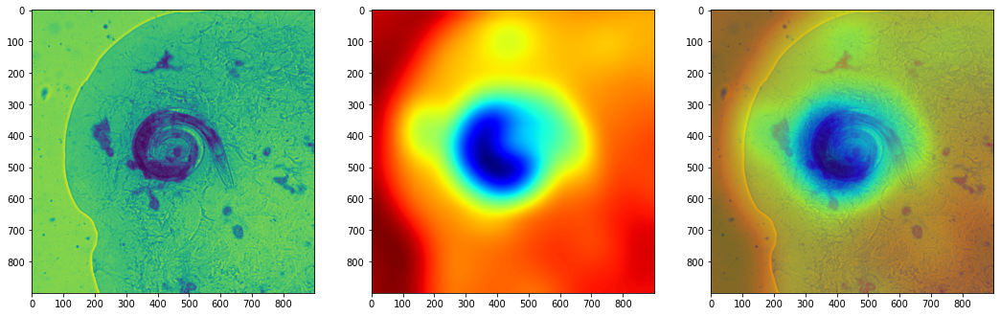

<Figure size 1296x432 with 0 Axes>

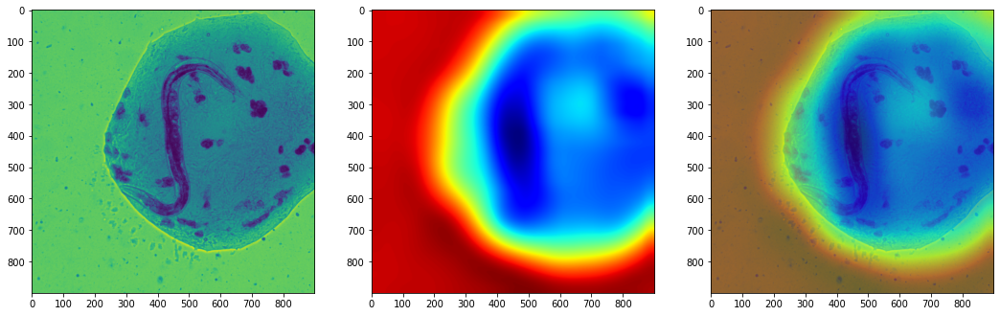

<Figure size 1296x432 with 0 Axes>

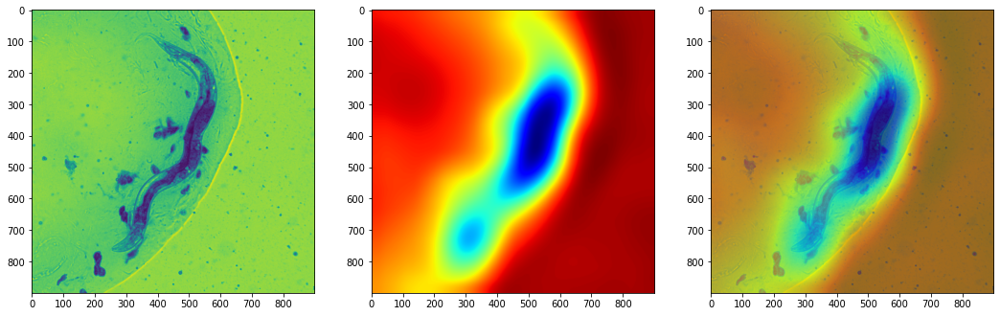

<Figure size 1296x432 with 0 Axes>

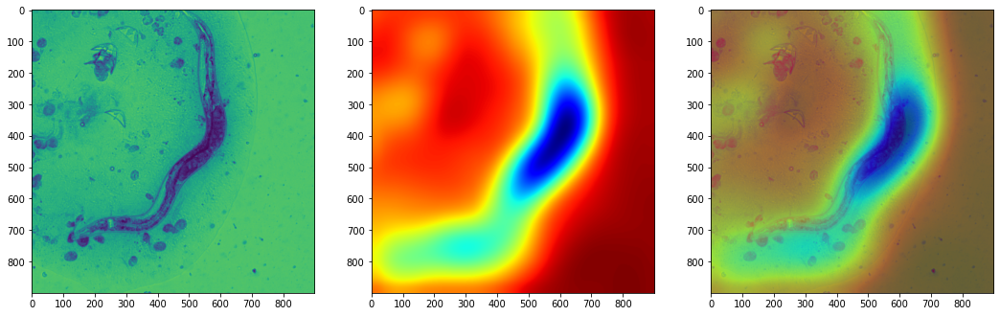

<Figure size 1296x432 with 0 Axes>

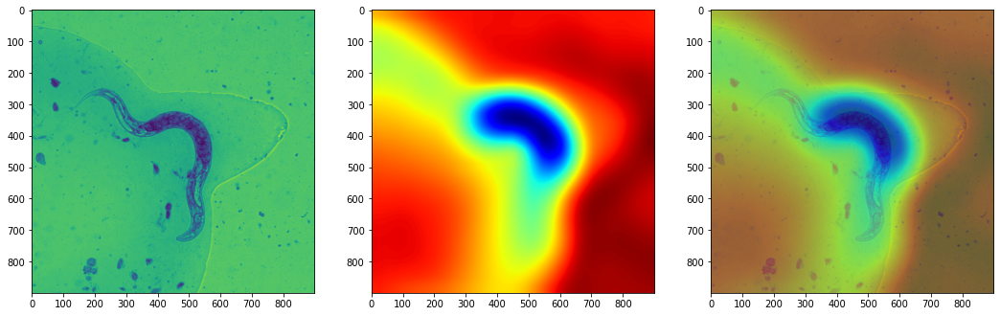

<Figure size 1296x432 with 0 Axes>

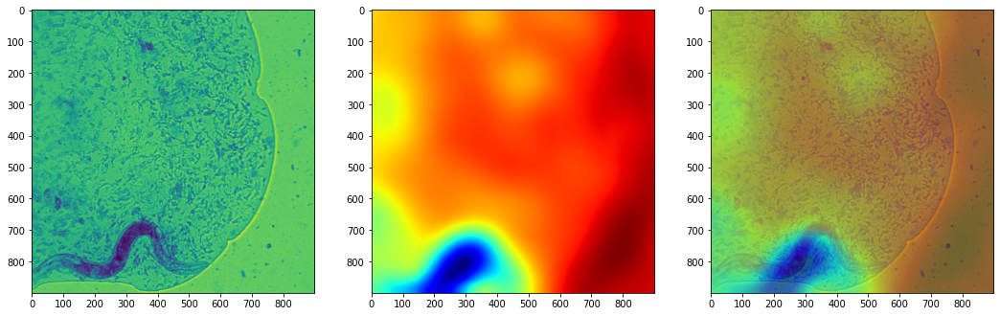

<Figure size 1296x432 with 0 Axes>

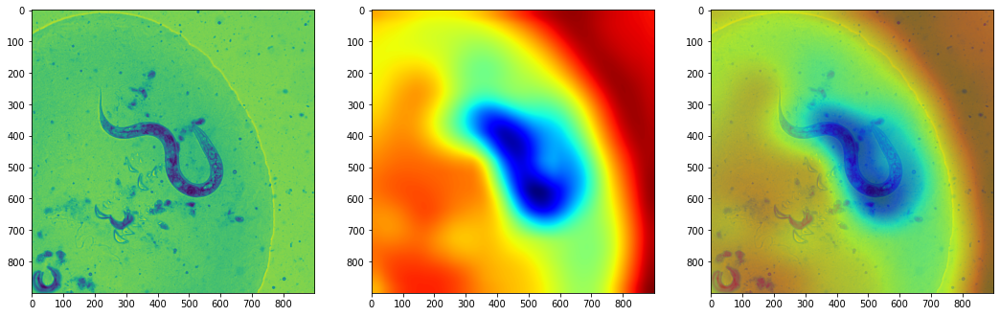

<Figure size 1296x432 with 0 Axes>

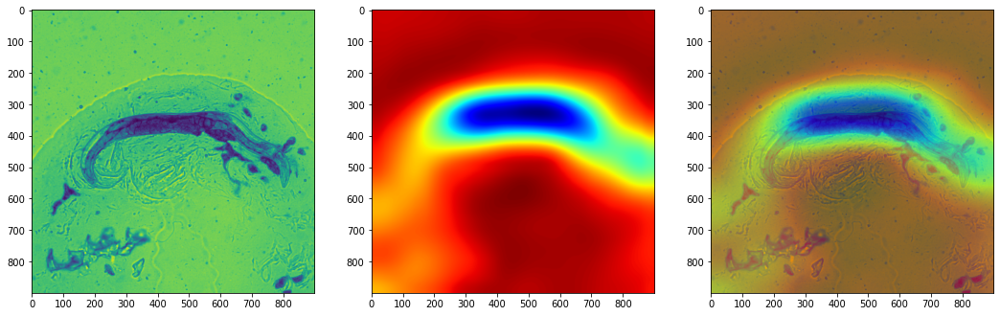

<Figure size 1296x432 with 0 Axes>

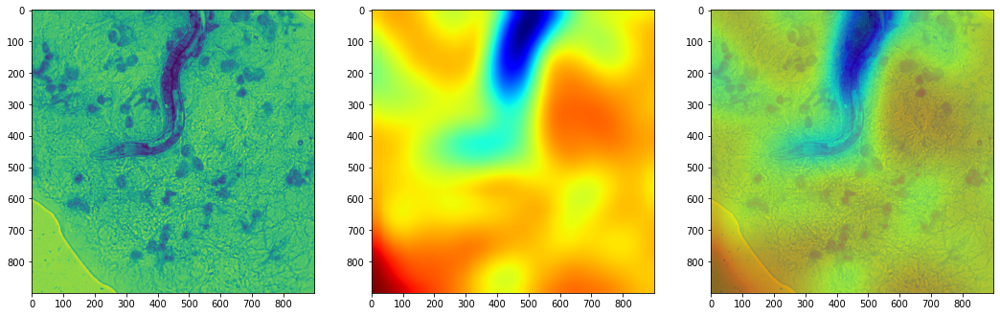

<Figure size 1296x432 with 0 Axes>

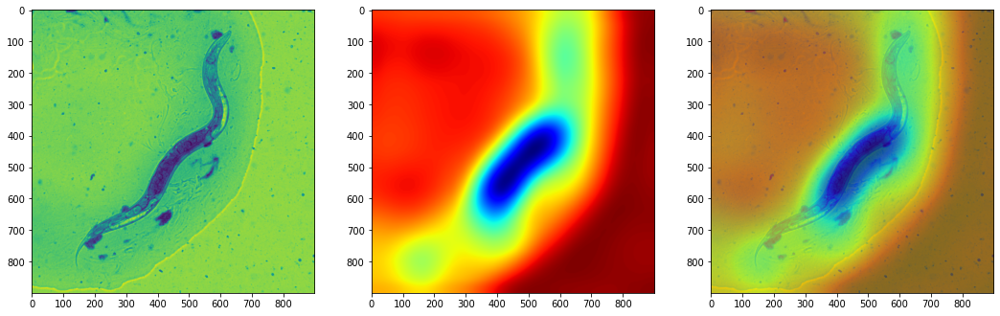

<Figure size 1296x432 with 0 Axes>

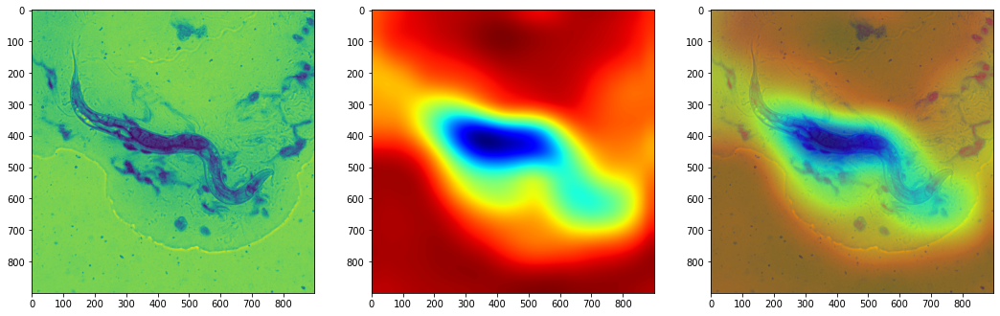

<Figure size 1296x432 with 0 Axes>

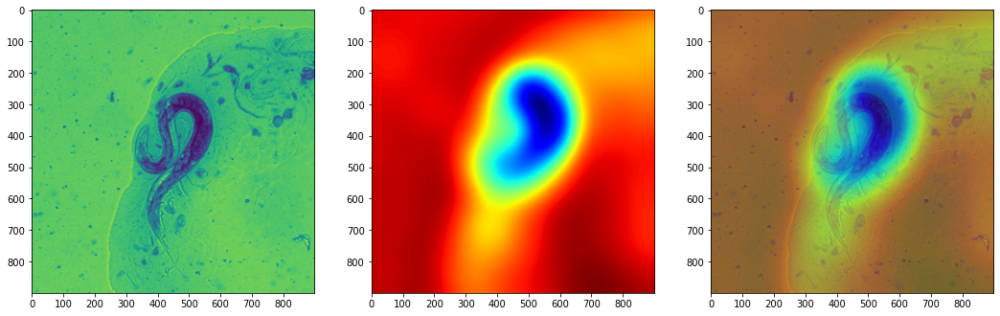

<Figure size 1296x432 with 0 Axes>

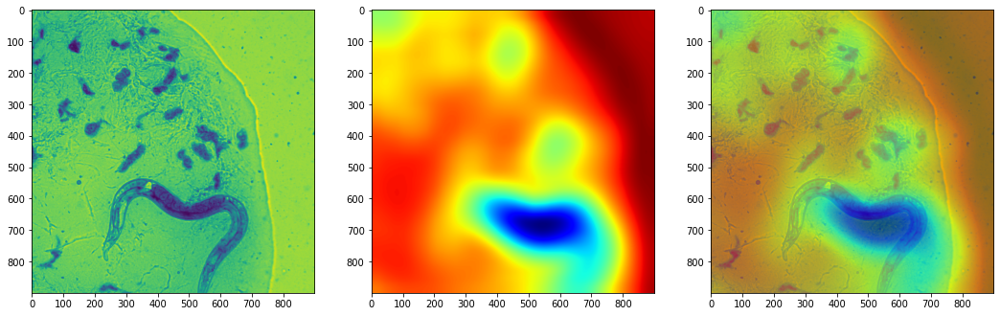

<Figure size 1296x432 with 0 Axes>

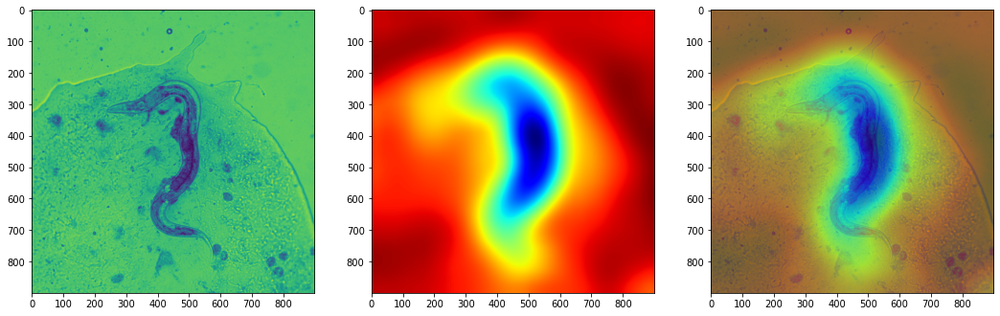

<Figure size 1296x432 with 0 Axes>

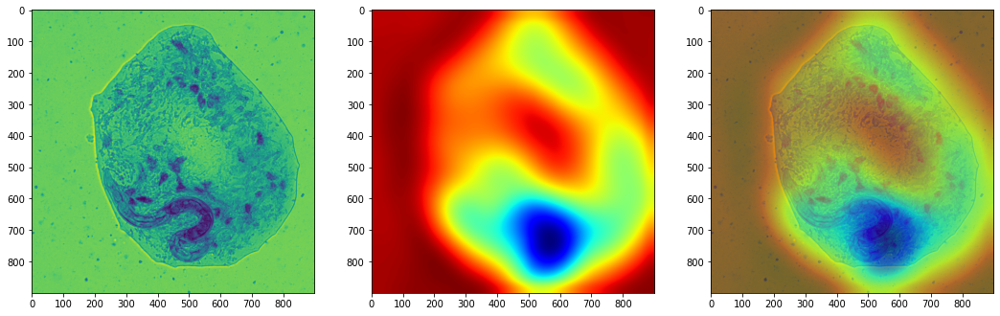

<Figure size 1296x432 with 0 Axes>

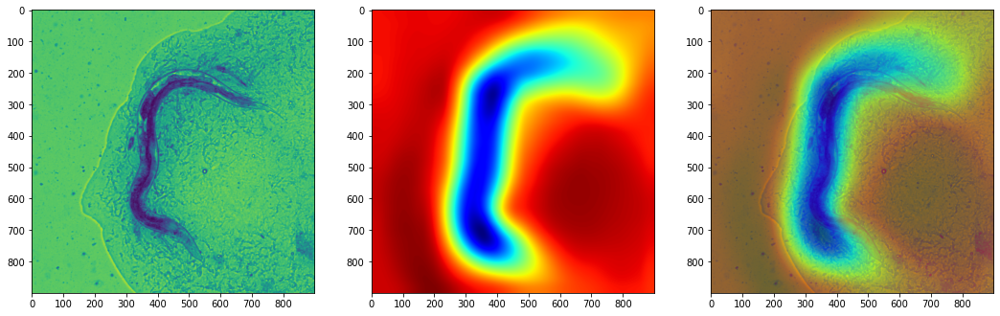

<Figure size 1296x432 with 0 Axes>

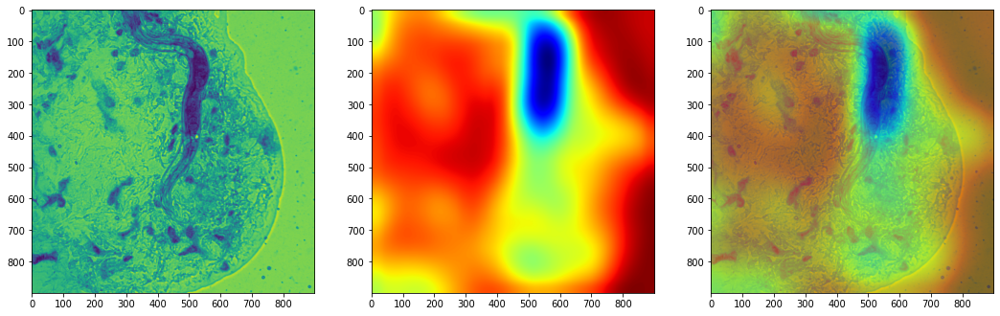

<Figure size 1296x432 with 0 Axes>

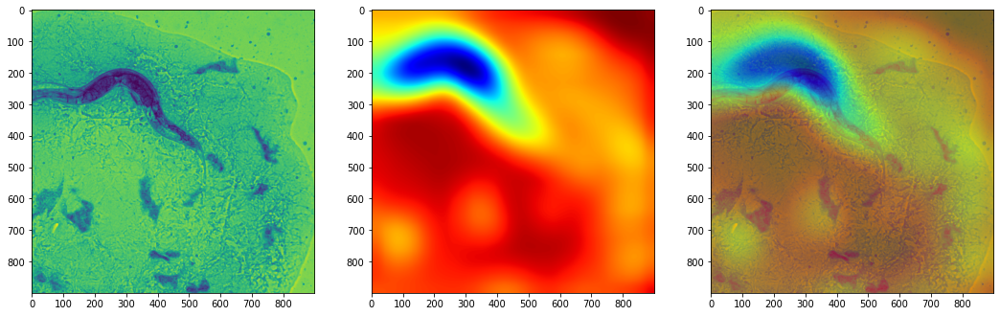

<Figure size 1296x432 with 0 Axes>

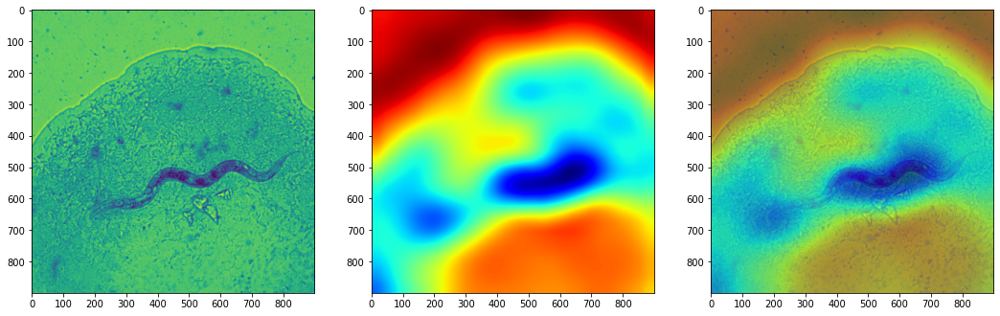

<Figure size 1296x432 with 0 Axes>

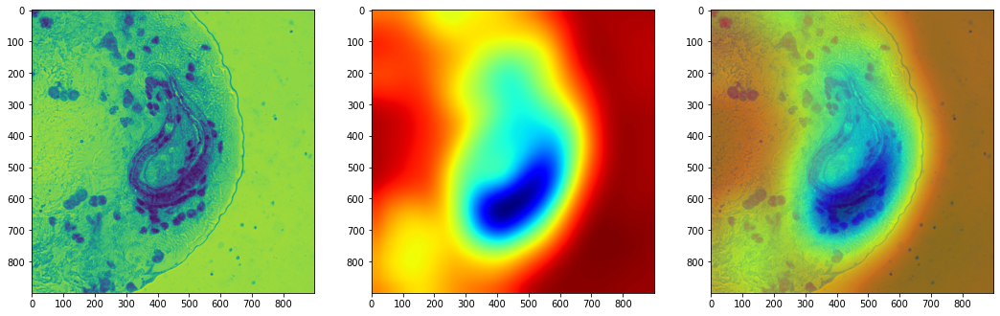

<Figure size 1296x432 with 0 Axes>

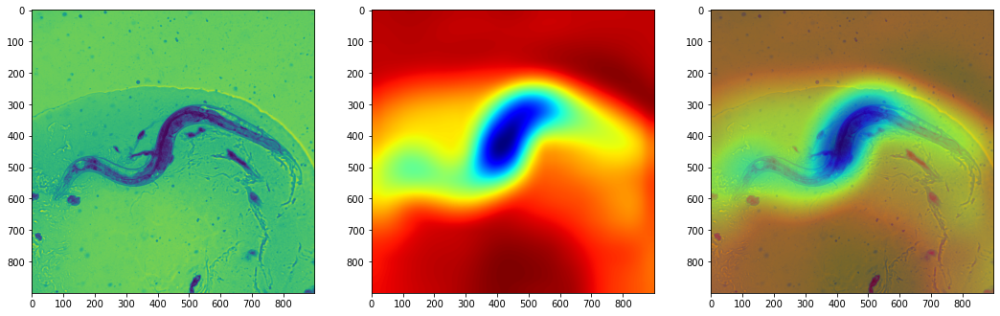

<Figure size 1296x432 with 0 Axes>

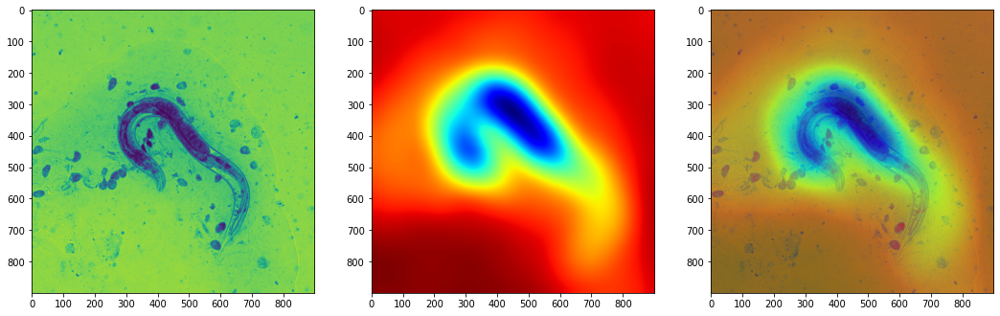

<Figure size 1296x432 with 0 Axes>

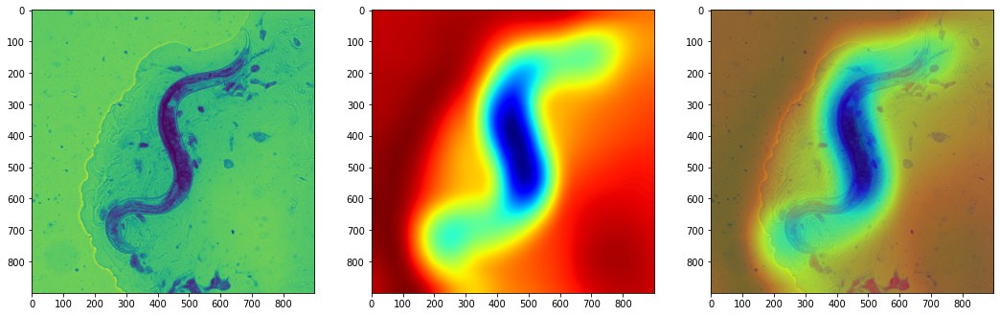

<Figure size 1296x432 with 0 Axes>

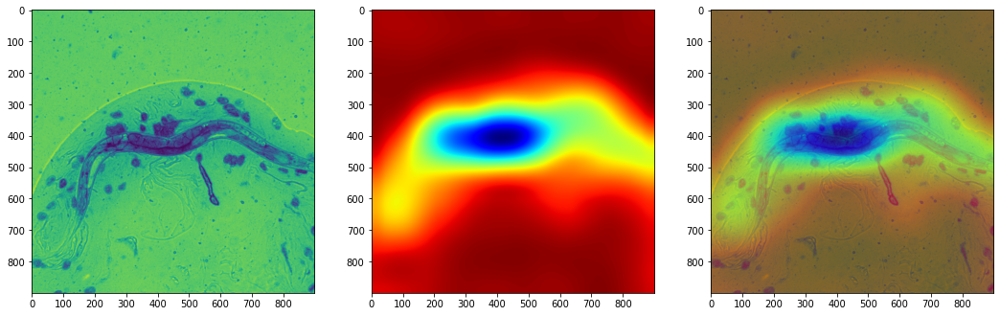

<Figure size 1296x432 with 0 Axes>

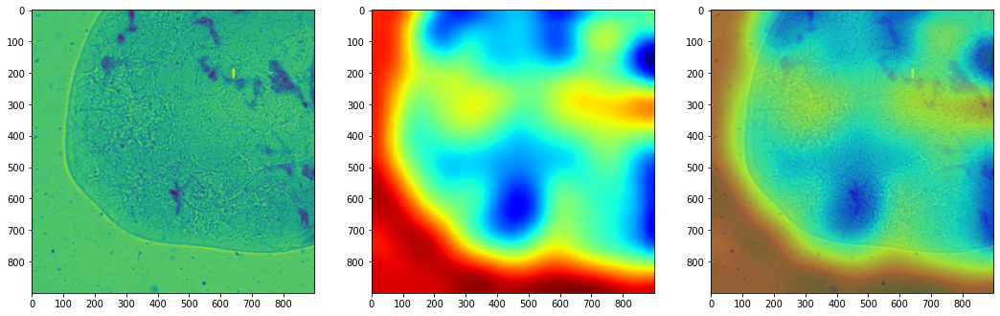

<Figure size 1296x432 with 0 Axes>

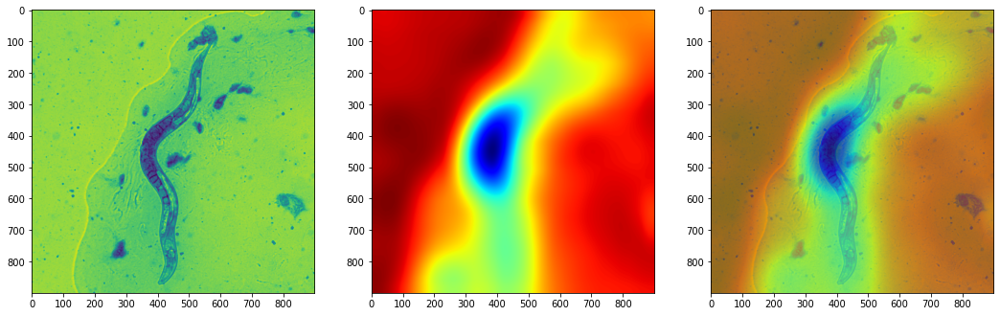

<Figure size 1296x432 with 0 Axes>

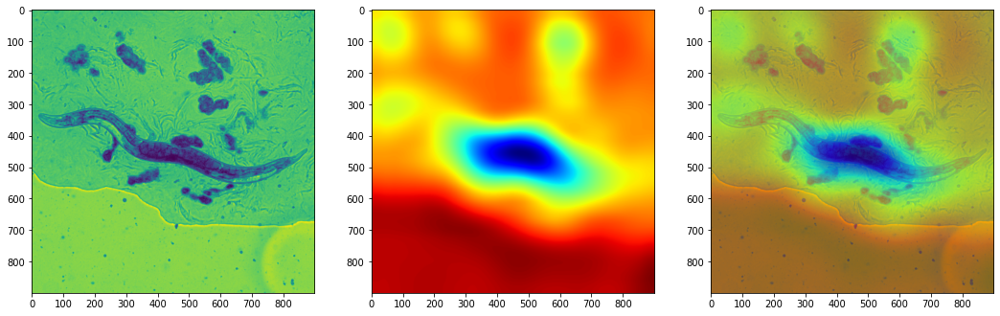

<Figure size 1296x432 with 0 Axes>

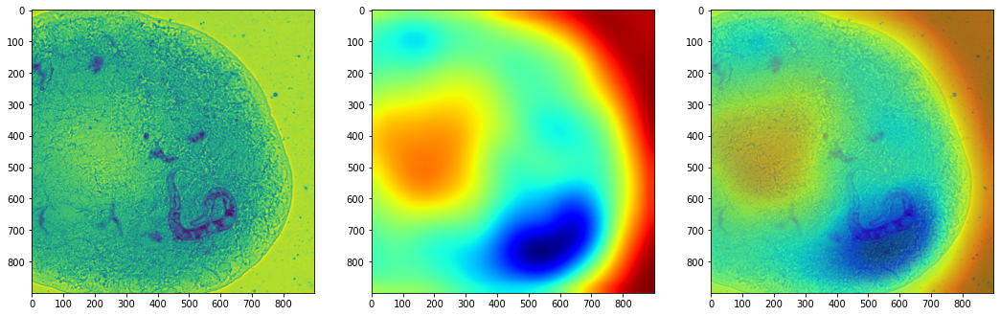

<Figure size 1296x432 with 0 Axes>

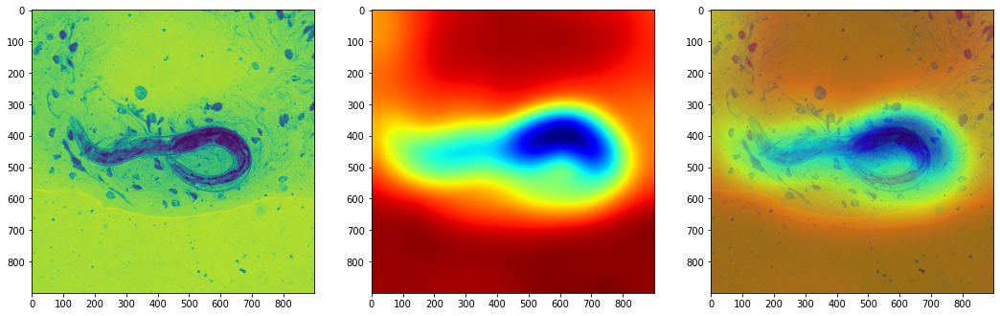

<Figure size 1296x432 with 0 Axes>

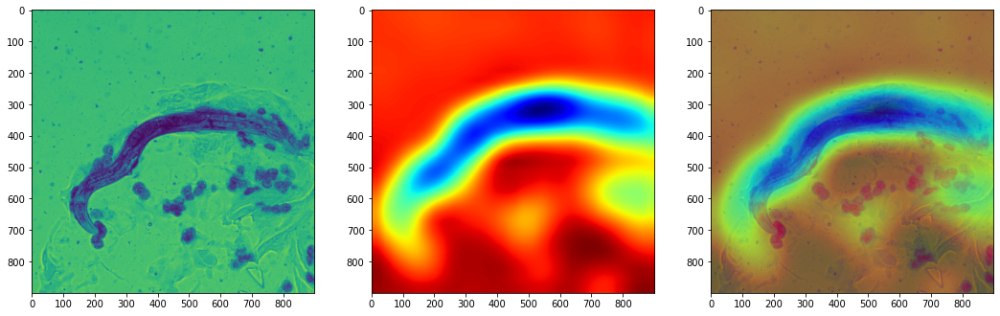

<Figure size 1296x432 with 0 Axes>

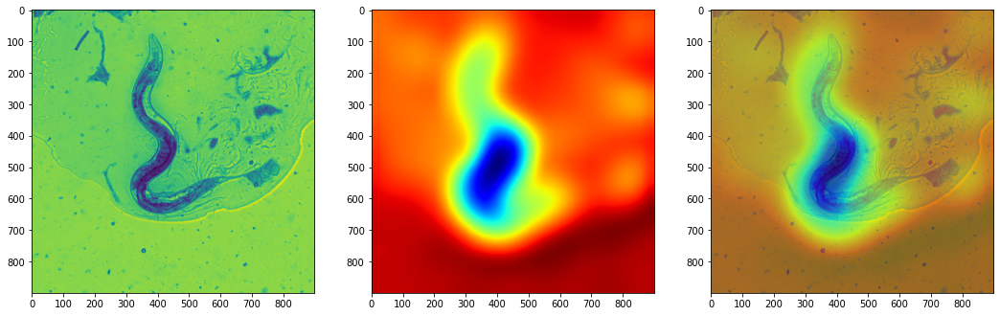

<Figure size 1296x432 with 0 Axes>

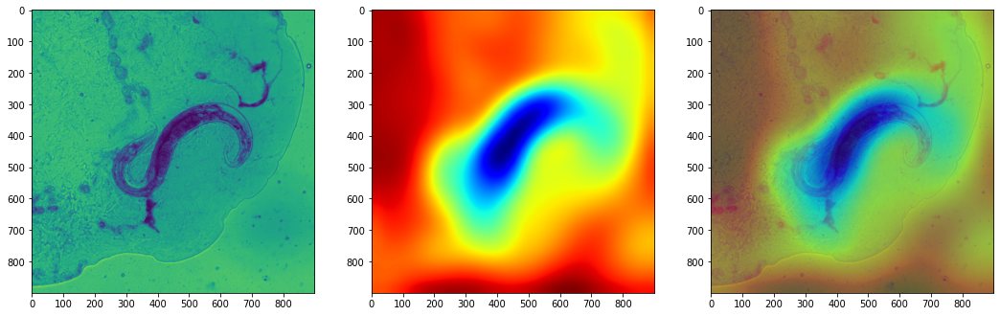

<Figure size 1296x432 with 0 Axes>

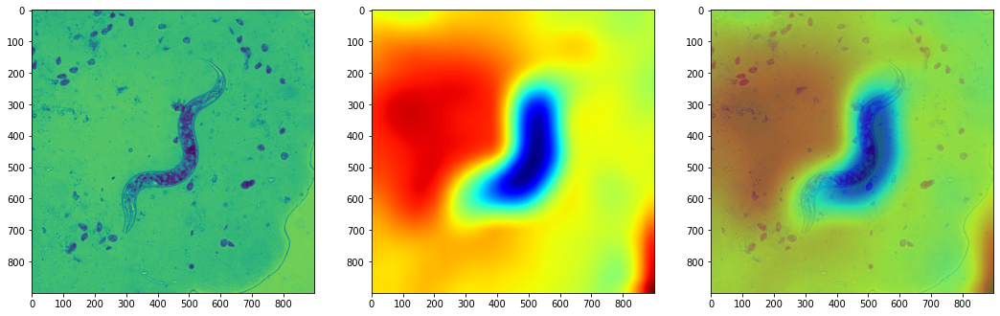

<Figure size 1296x432 with 0 Axes>

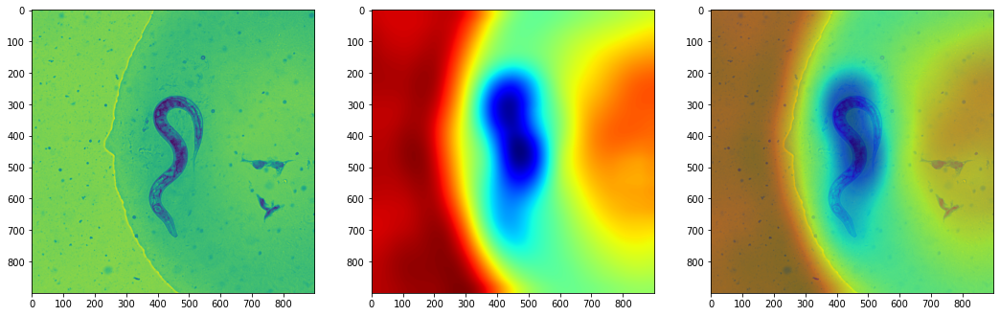

<Figure size 1296x432 with 0 Axes>

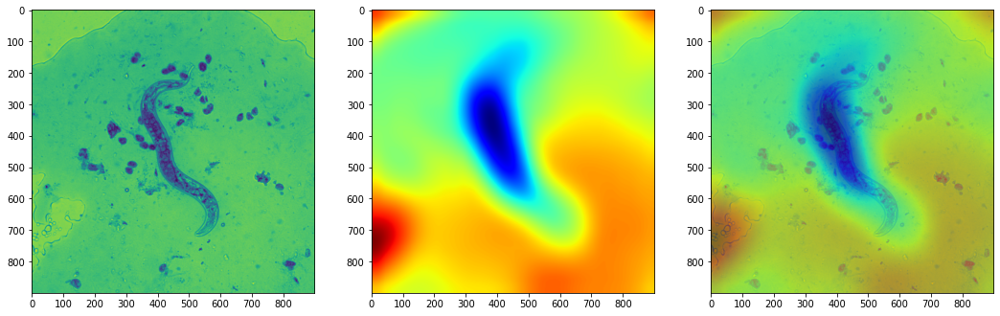

<Figure size 1296x432 with 0 Axes>

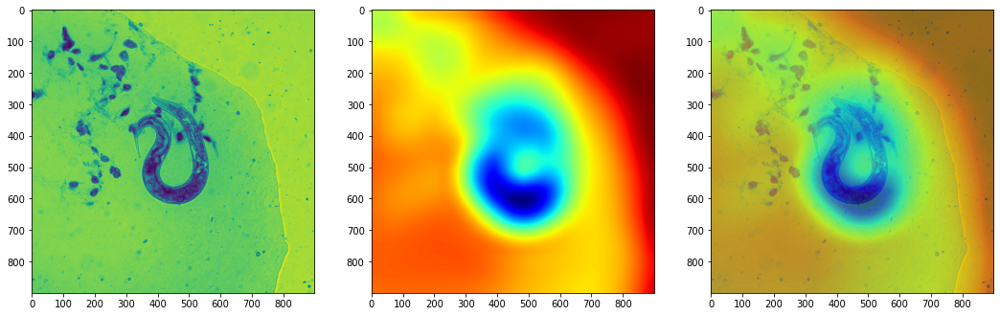

<Figure size 1296x432 with 0 Axes>

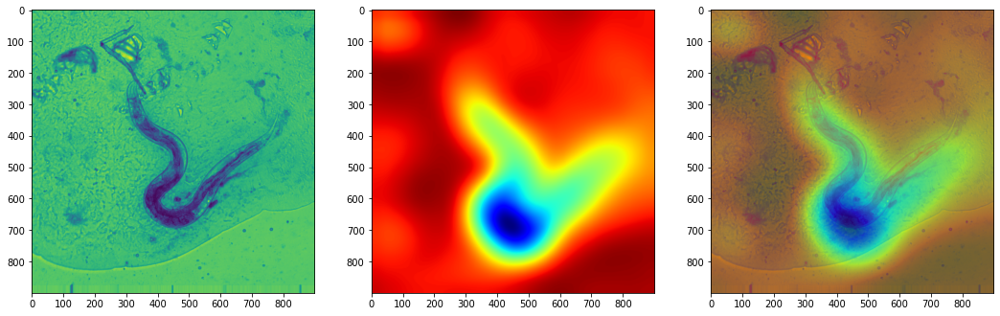

<Figure size 1296x432 with 0 Axes>

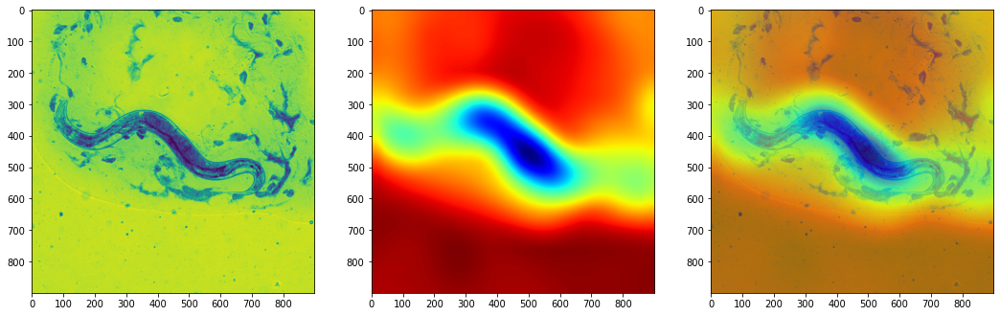

<Figure size 1296x432 with 0 Axes>

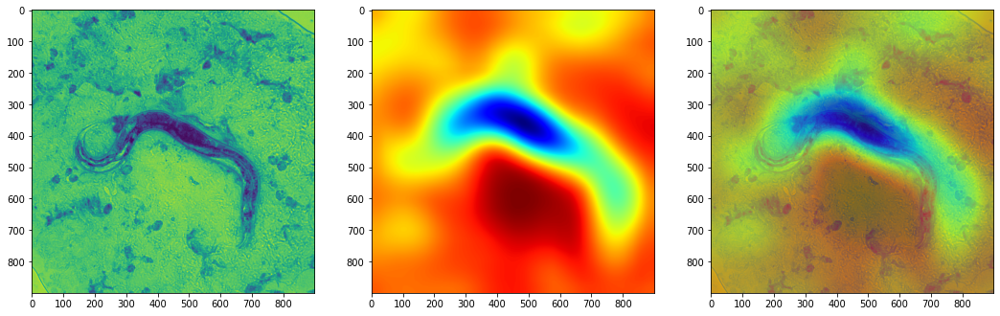

<Figure size 1296x432 with 0 Axes>

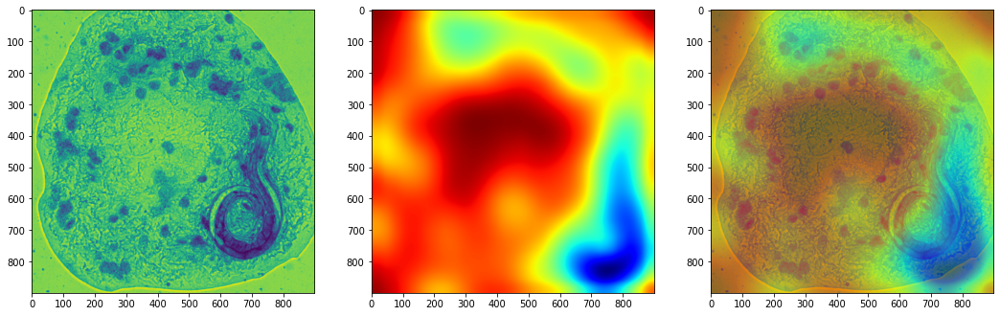

<Figure size 1296x432 with 0 Axes>

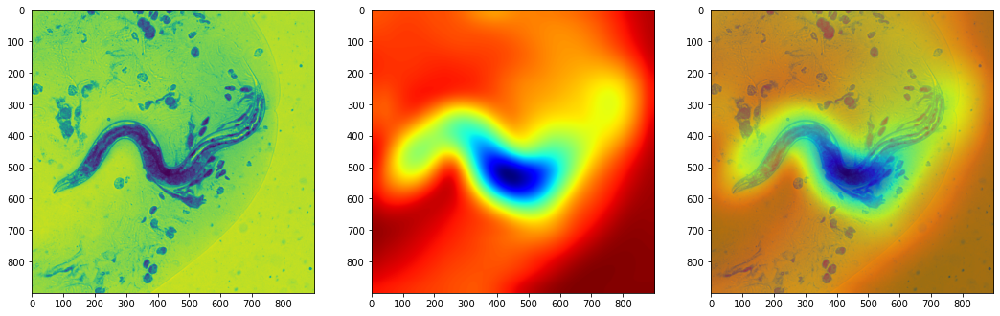

<Figure size 1296x432 with 0 Axes>

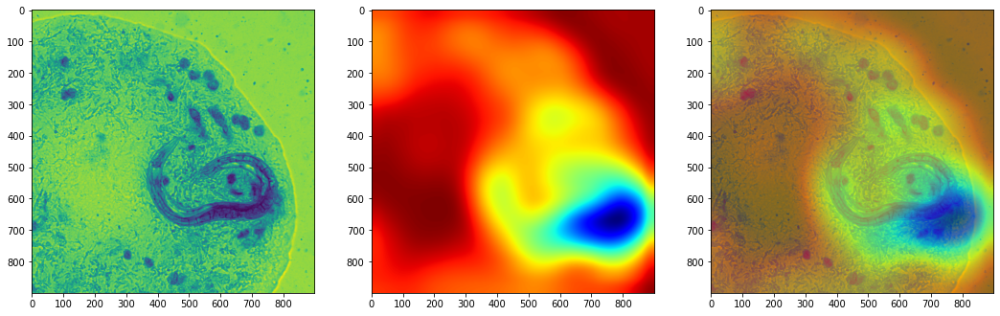

<Figure size 1296x432 with 0 Axes>

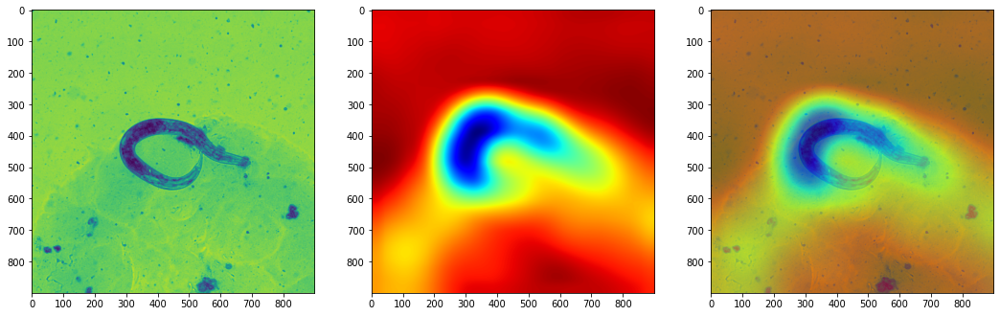

<Figure size 1296x432 with 0 Axes>

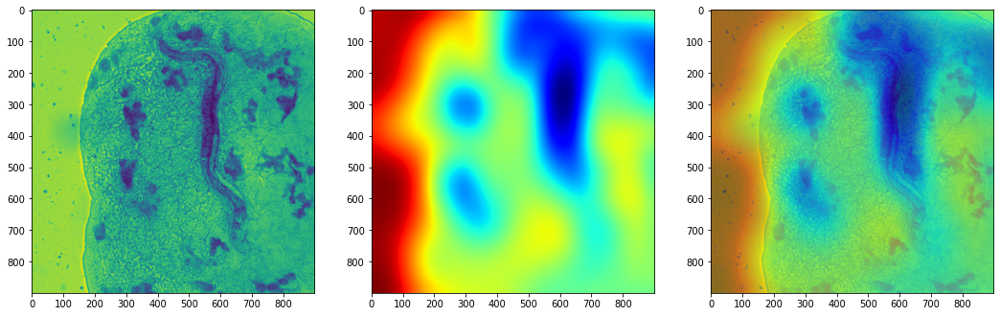

<Figure size 1296x432 with 0 Axes>

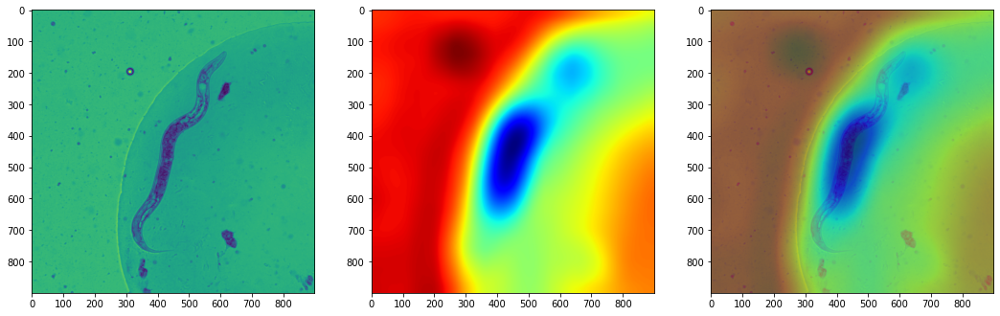

<Figure size 1296x432 with 0 Axes>

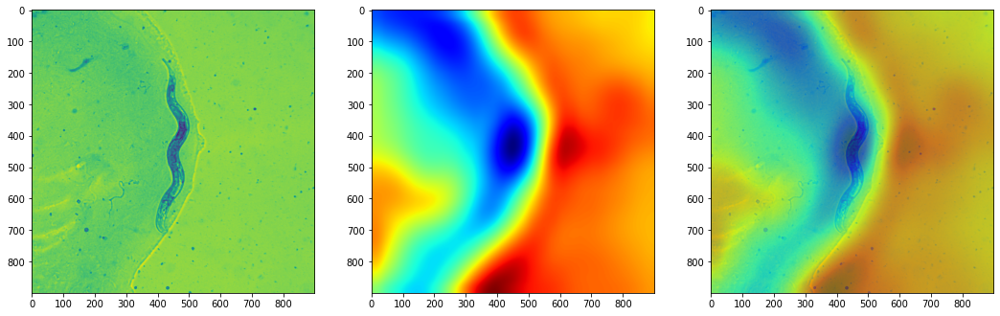

<Figure size 1296x432 with 0 Axes>

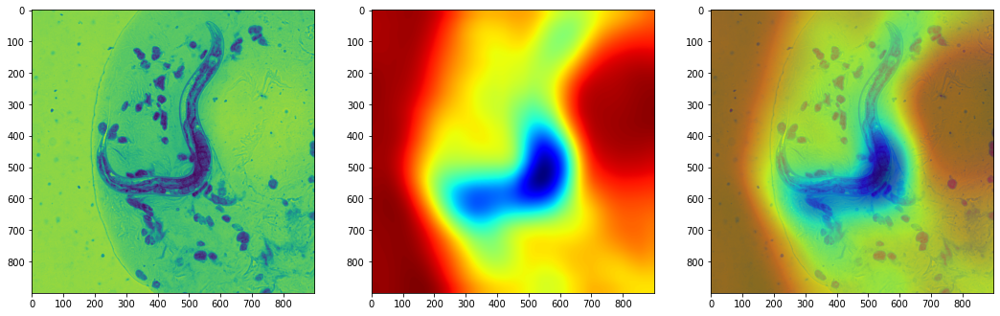

<Figure size 1296x432 with 0 Axes>

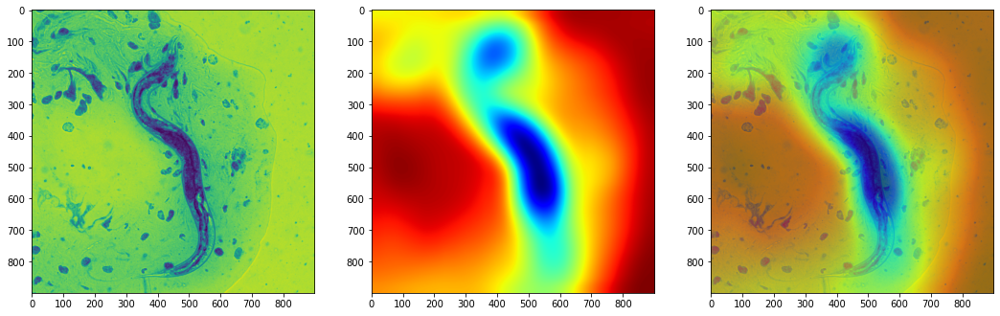

<Figure size 1296x432 with 0 Axes>

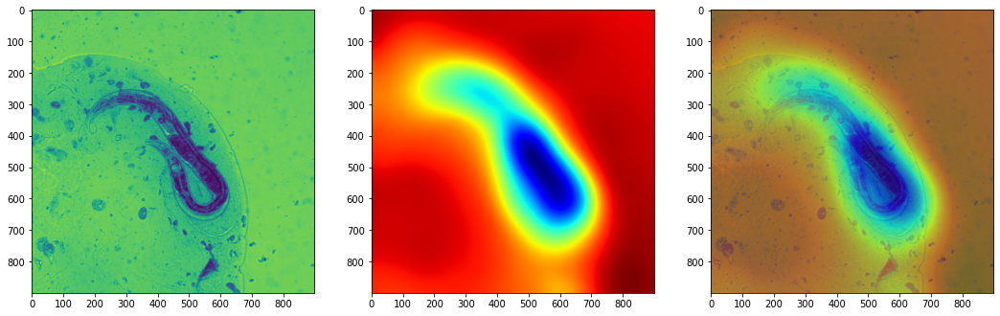

<Figure size 1296x432 with 0 Axes>

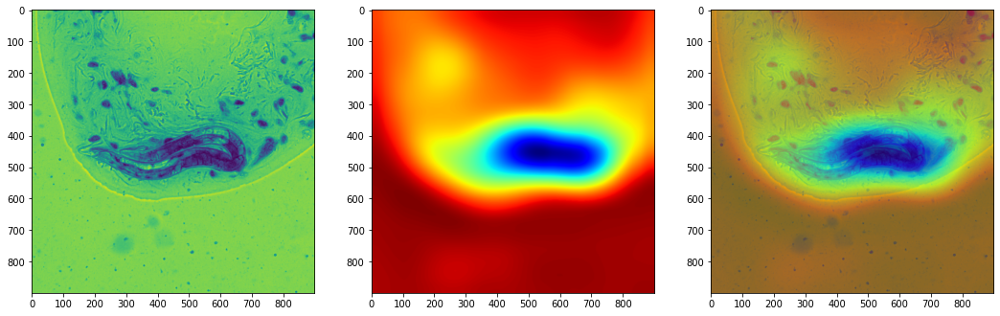

<Figure size 1296x432 with 0 Axes>

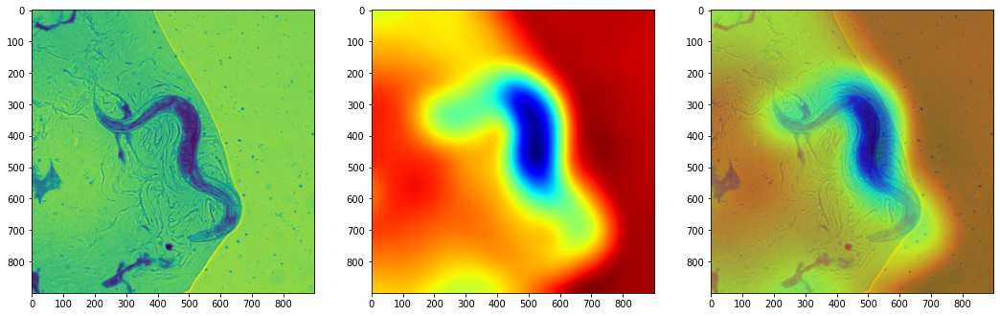

<Figure size 1296x432 with 0 Axes>

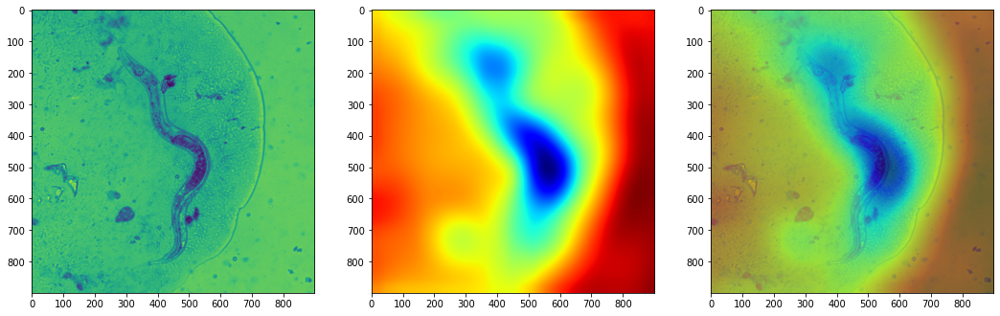

<Figure size 1296x432 with 0 Axes>

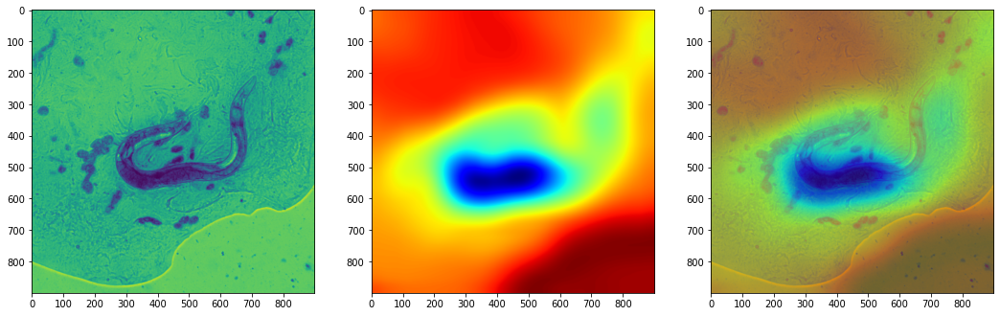

<Figure size 1296x432 with 0 Axes>

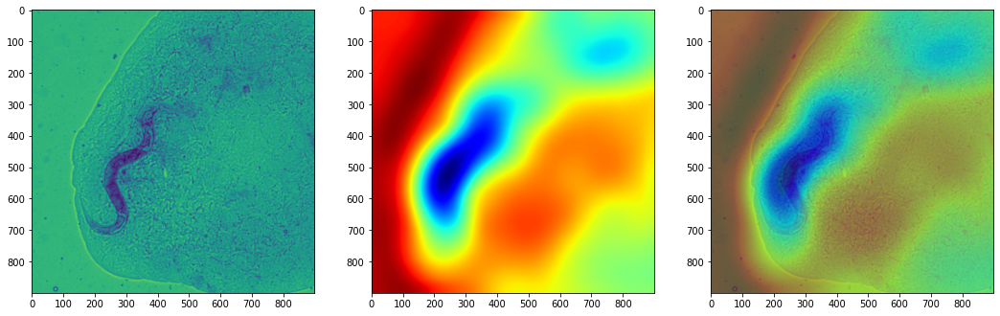

<Figure size 1296x432 with 0 Axes>

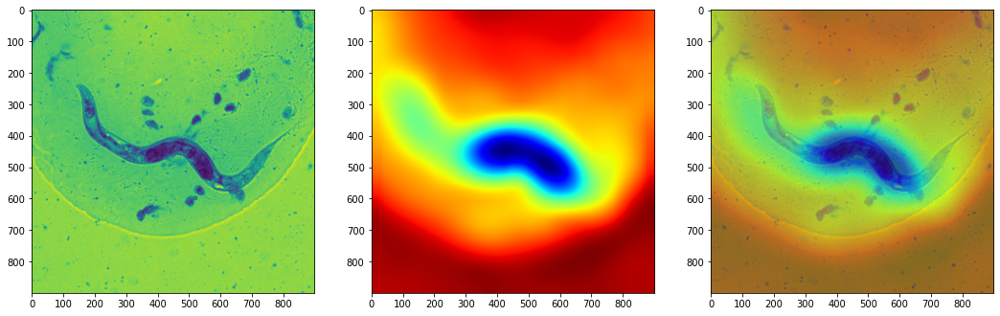

<Figure size 1296x432 with 0 Axes>

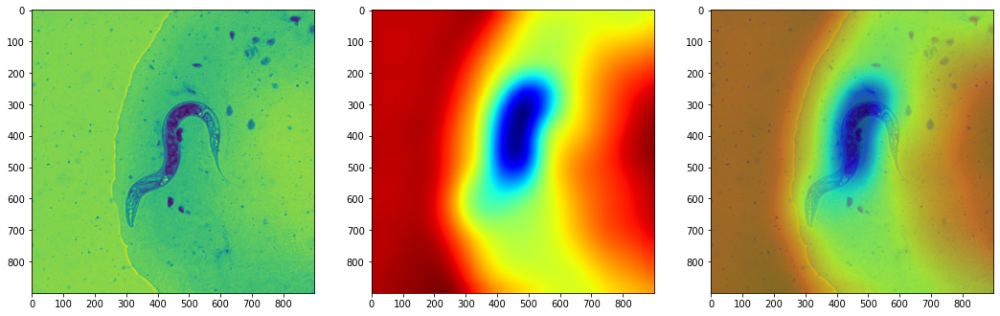

<Figure size 1296x432 with 0 Axes>

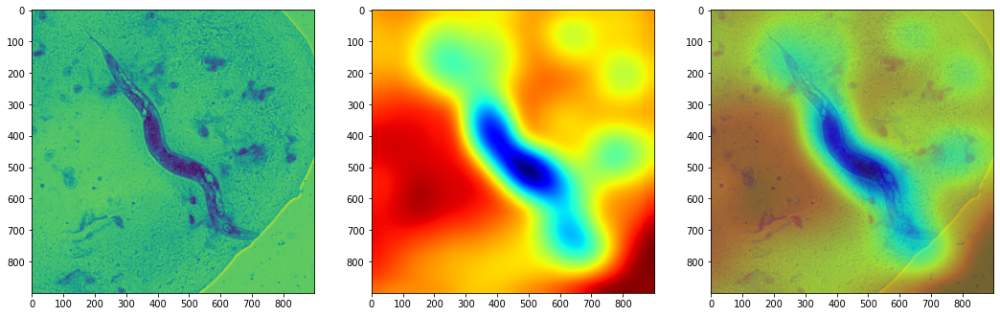

<Figure size 1296x432 with 0 Axes>

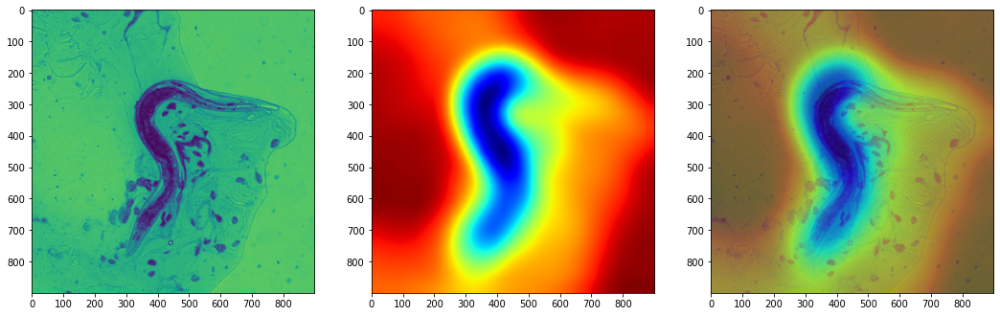

<Figure size 1296x432 with 0 Axes>

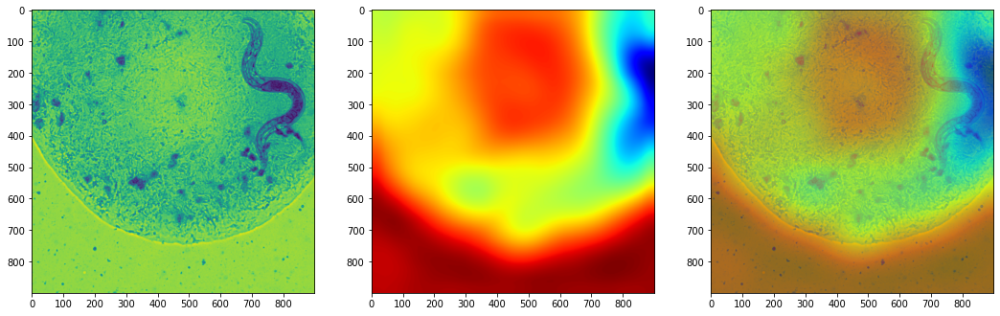

<Figure size 1296x432 with 0 Axes>

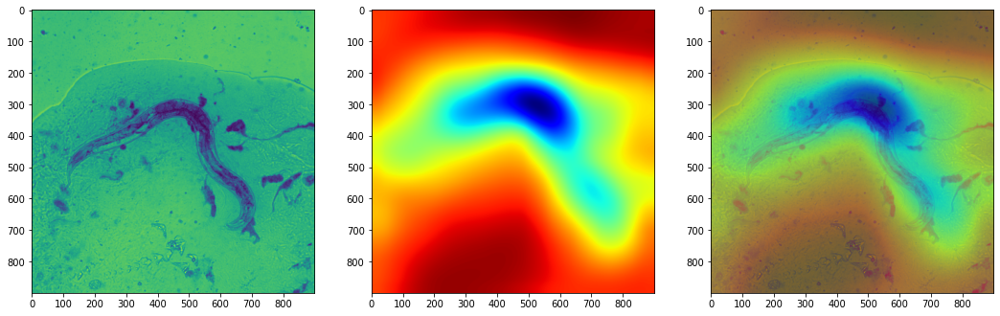

<Figure size 1296x432 with 0 Axes>

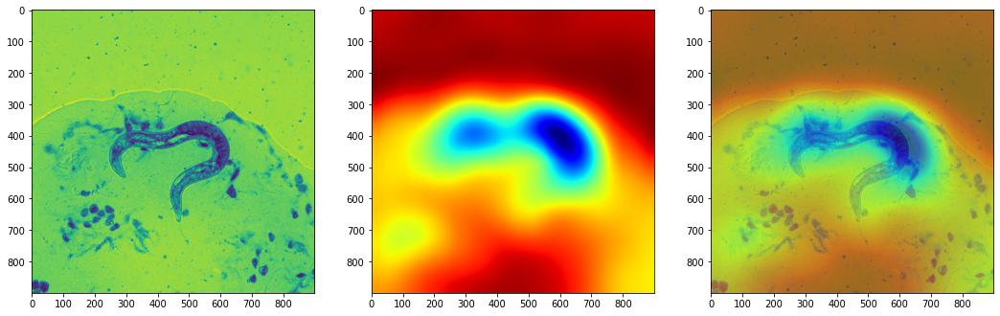

<Figure size 1296x432 with 0 Axes>

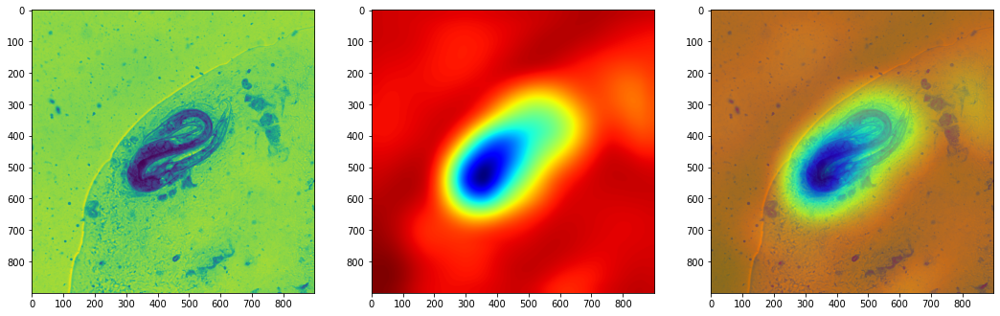

<Figure size 1296x432 with 0 Axes>

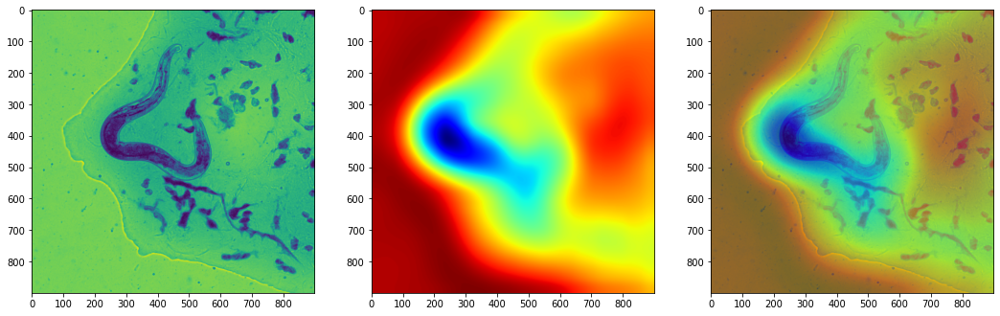

<Figure size 1296x432 with 0 Axes>

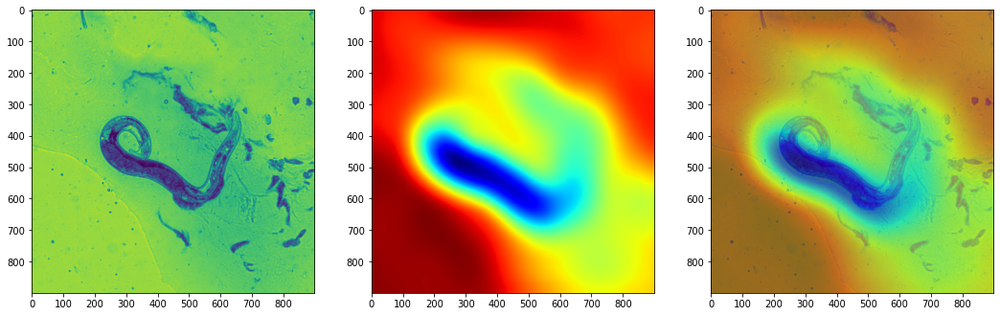

<Figure size 1296x432 with 0 Axes>

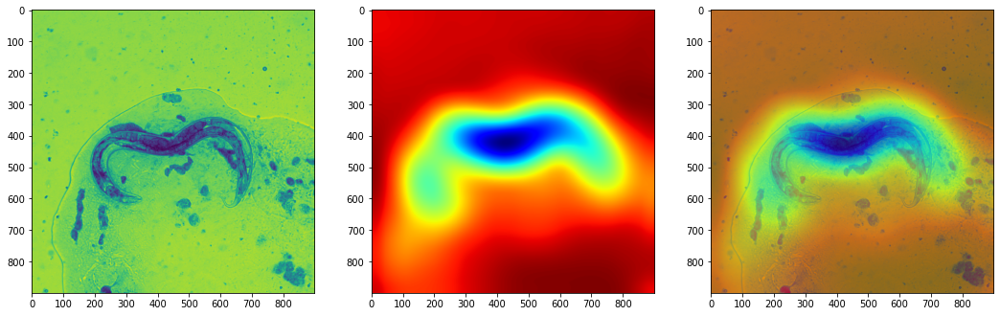

<Figure size 1296x432 with 0 Axes>

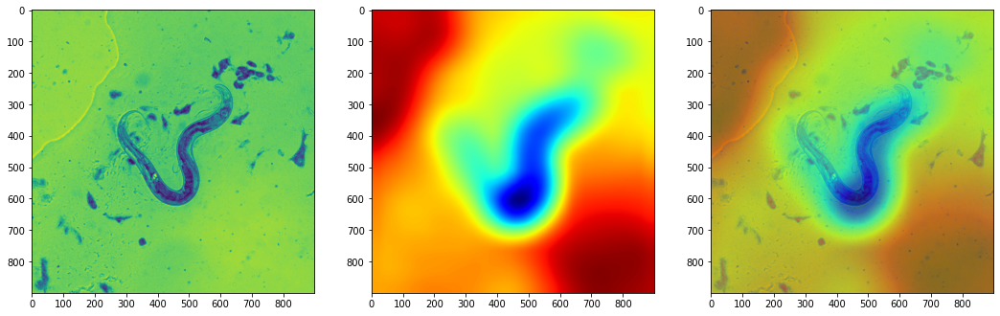

<Figure size 1296x432 with 0 Axes>

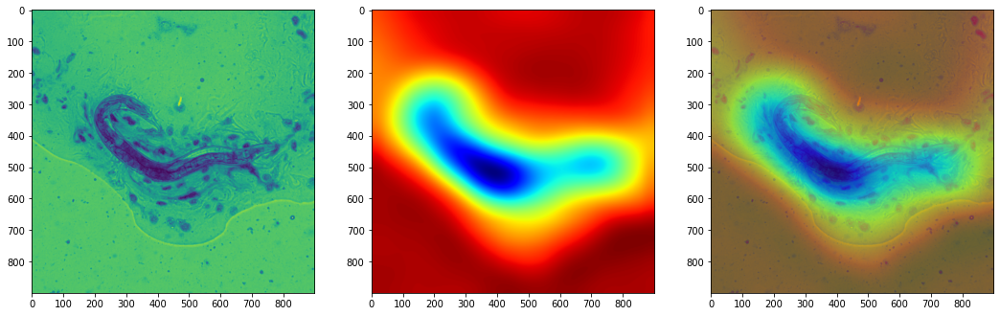

<Figure size 1296x432 with 0 Axes>

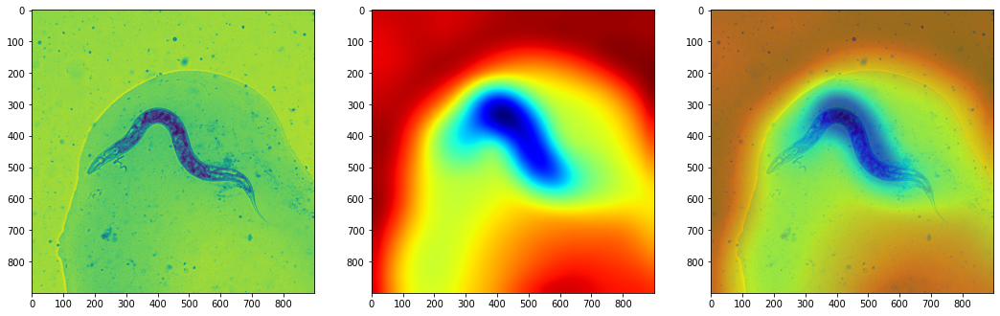

<Figure size 1296x432 with 0 Axes>

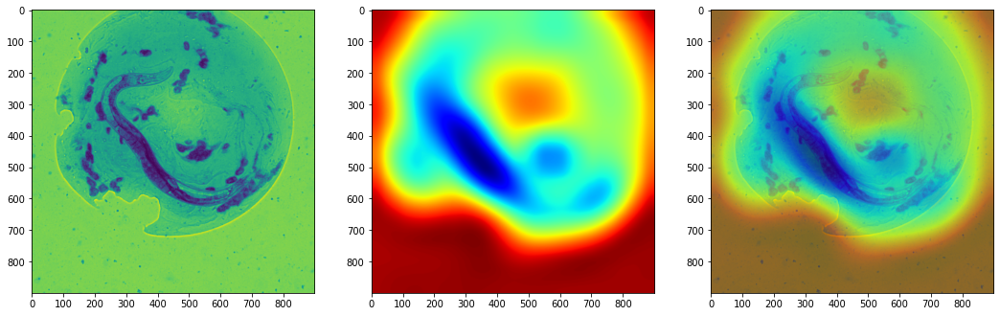

<Figure size 1296x432 with 0 Axes>

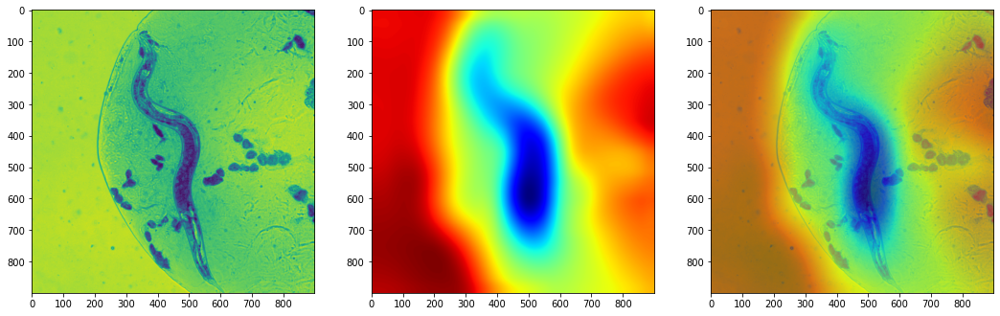

<Figure size 1296x432 with 0 Axes>

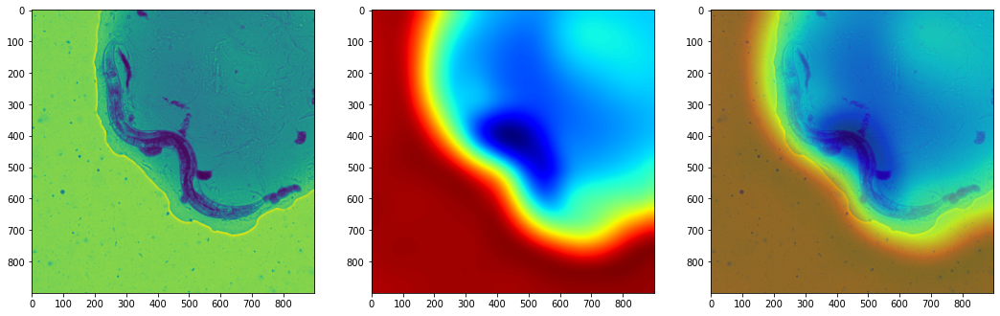

<Figure size 1296x432 with 0 Axes>

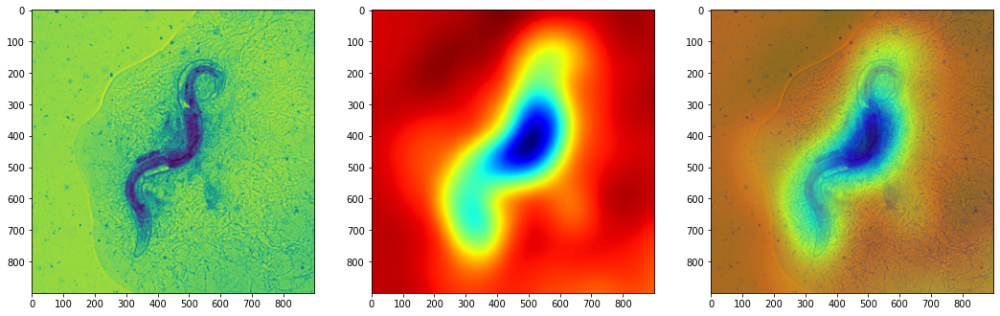

<Figure size 1296x432 with 0 Axes>

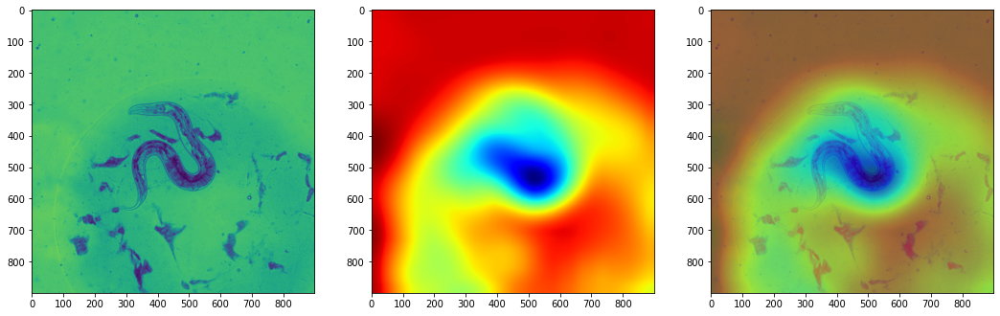

<Figure size 1296x432 with 0 Axes>

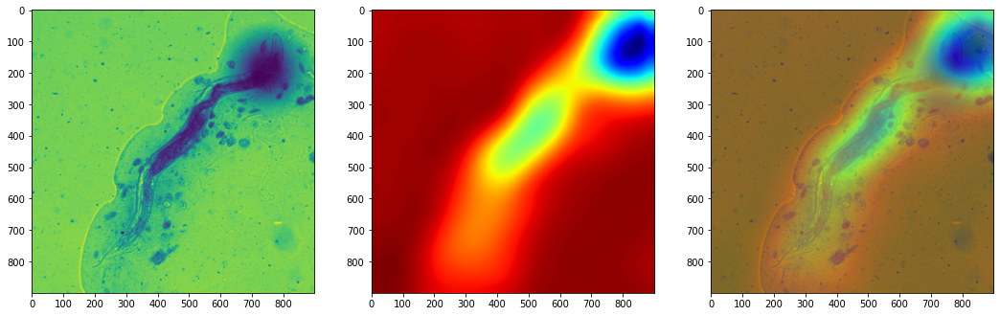

<Figure size 1296x432 with 0 Axes>

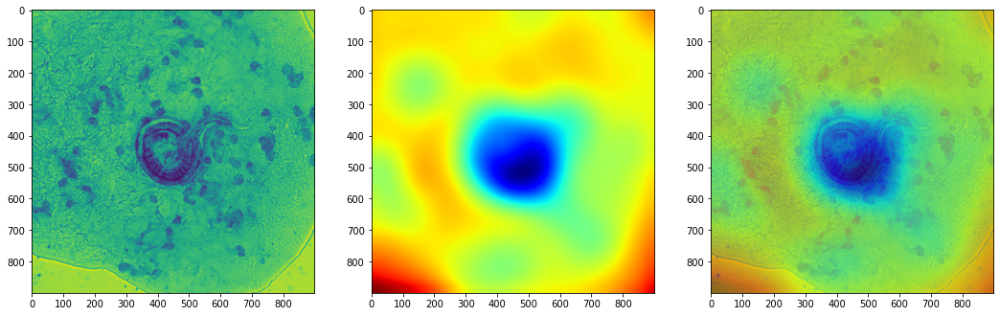

<Figure size 1296x432 with 0 Axes>

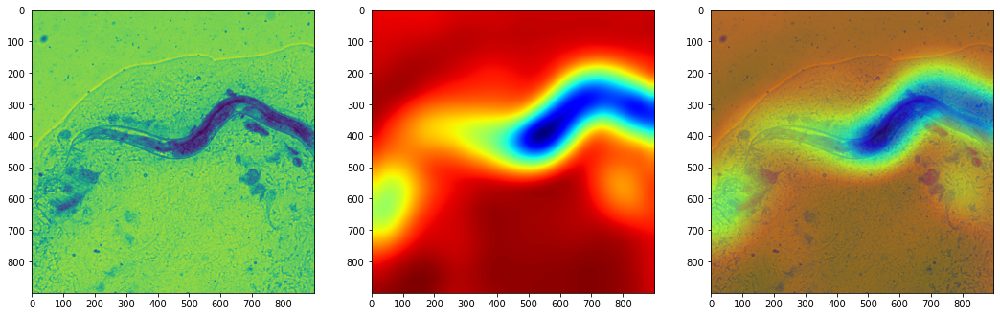

<Figure size 1296x432 with 0 Axes>

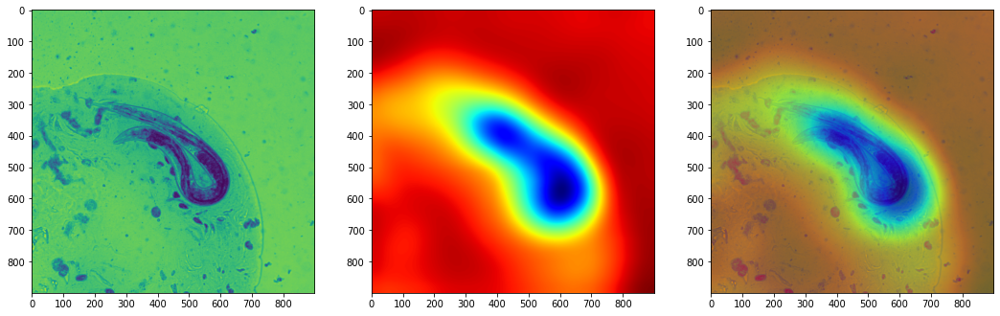

<Figure size 1296x432 with 0 Axes>

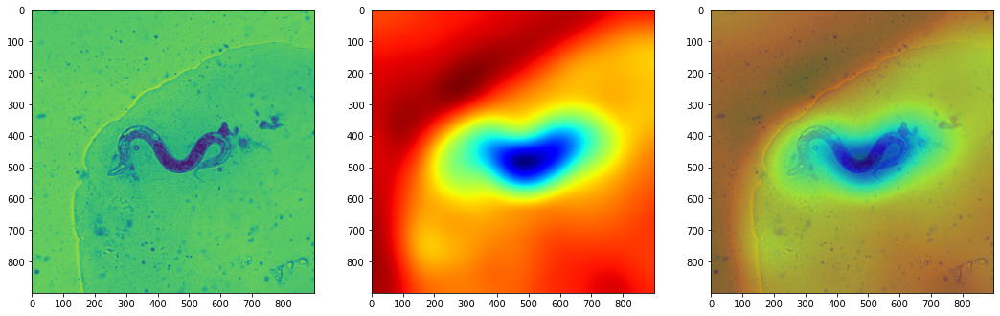

<Figure size 1296x432 with 0 Axes>

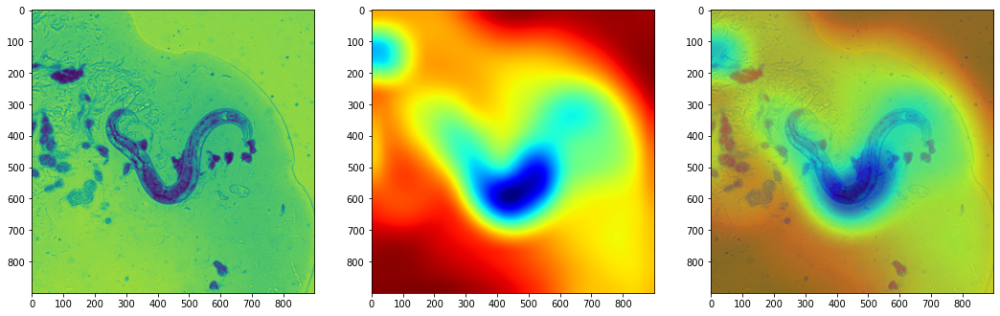

<Figure size 1296x432 with 0 Axes>

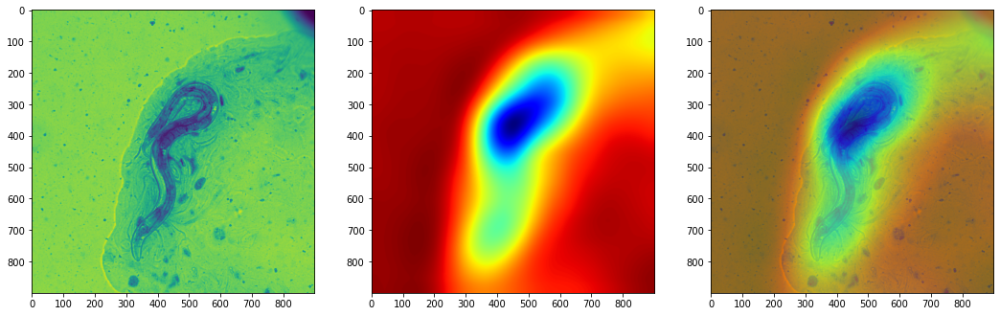

<Figure size 1296x432 with 0 Axes>

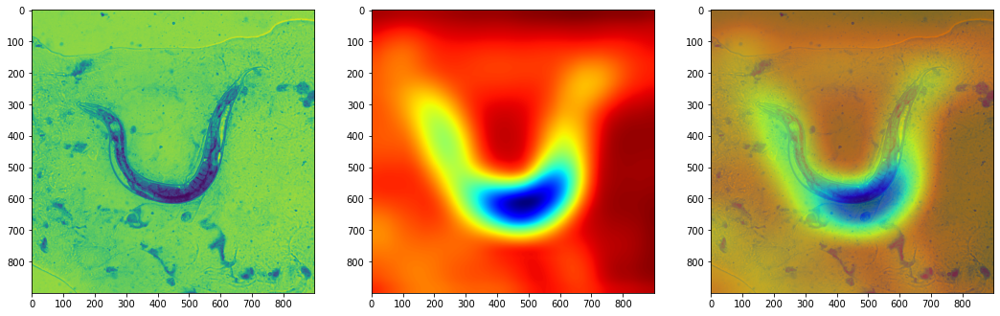

<Figure size 1296x432 with 0 Axes>

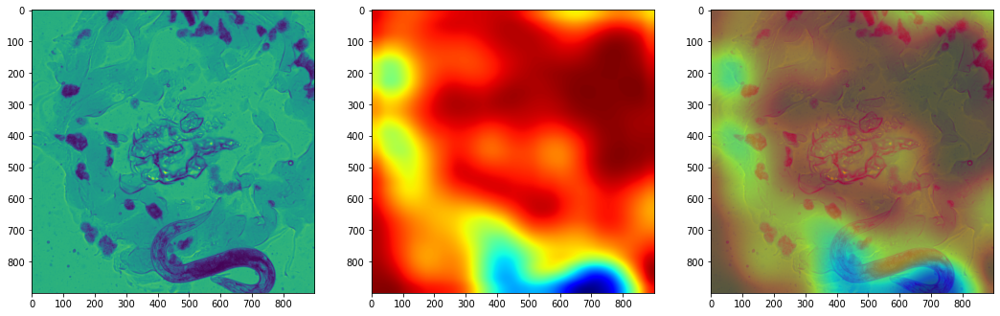

<Figure size 1296x432 with 0 Axes>

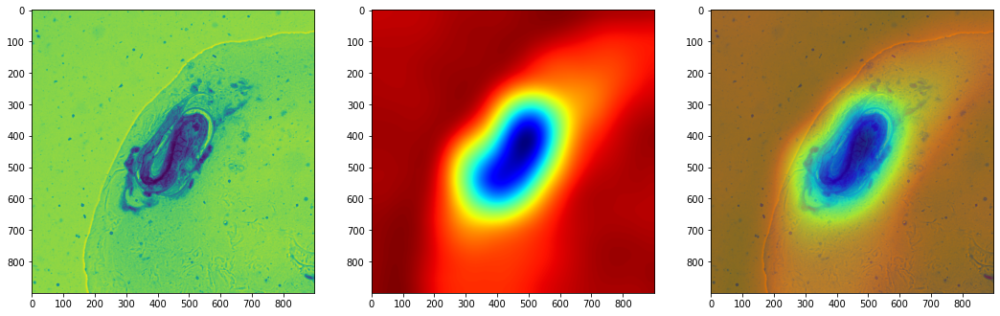

<Figure size 1296x432 with 0 Axes>

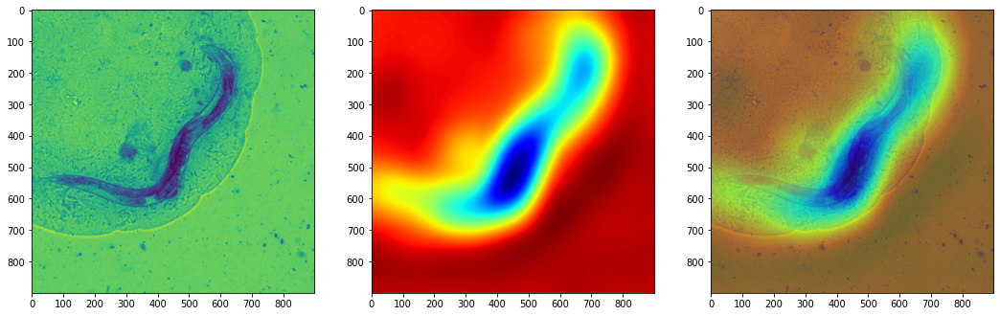

<Figure size 1296x432 with 0 Axes>

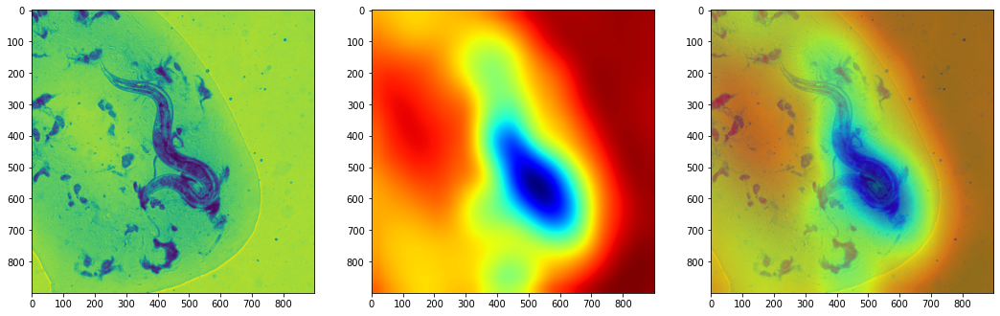

<Figure size 1296x432 with 0 Axes>

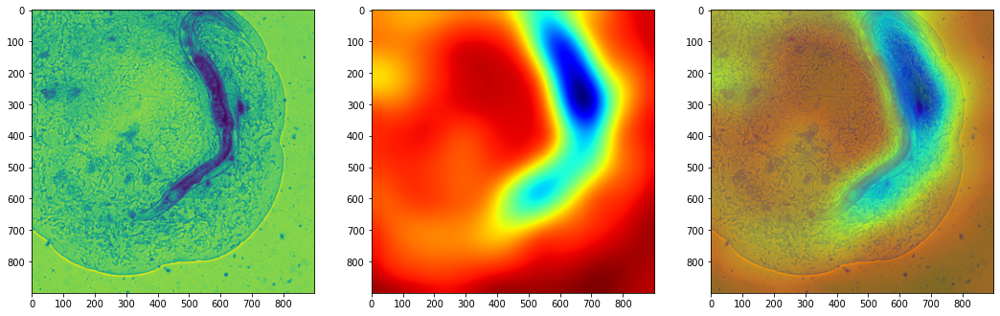

<Figure size 1296x432 with 0 Axes>

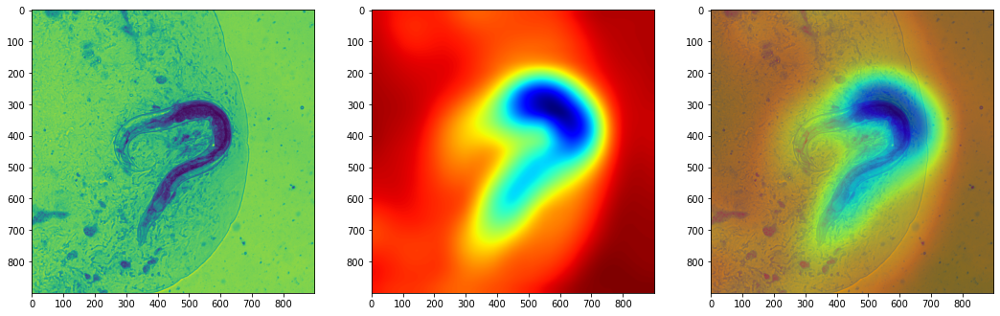

<Figure size 1296x432 with 0 Axes>

Buffered data was truncated after reaching the output size limit.

In [ ]:
testFolder = '/content/drive/My Drive/worm_models/lifespan/test_images/3d/long'
images = listImages(testFolder,".png")
print(images)
#imageFolder = os.path.join(testFolder,'CAM')
#checkDir(imageFolder)          
#layer_idx = utils.find_layer_idx(model,'avg_pool')
plt.rcParams['figure.figsize']=(18,6)

for image in images:
    imgPath = os.path.join(testFolder,image)
    im = cv2.resize(cv2.imread(imgPath, cv2.IMREAD_GRAYSCALE), (img_width, img_height))
    im = np.round(im.astype(float)*2.6).astype(int).reshape(img_width, img_height, 1)
    #plt.imshow(im)
    plt.figure()
    modifier = 'guided'
    #modifier = 'relu'
    #grads = visualize_saliency(model, layer_idx, filter_indices=0, seed_input=im, backprop_modifier=modifier)
    grads = visualize_cam(model, layer_idx=17, filter_indices=None, seed_input=im, backprop_modifier=modifier)
    file_name = re.sub(r"png", "pdf",imgPath)
    plotNSave(np.squeeze(im),file_name,grads)
    cv2.imwrite(file_name.replace('.pdf','_cam.tif'),grads)